In [ ]:
!pip list

In [ ]:
!pip install ultralytics
!pip install roboflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.5/644.5 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.2 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!yolo checks

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 27.3/78.2 GB disk)

OS                  Linux-5.15.120+-x86_64-with-glibc2.35
Environment         Colab
Python              3.10.12
Install             pip
RAM                 12.68 GB
CPU                 Intel Xeon 2.00GHz
CUDA                11.8

matplotlib          ✅ 3.7.1>=3.3.0
numpy               ✅ 1.23.5>=1.22.2
opencv-python       ✅ 4.8.0.76>=4.6.0
pillow              ✅ 9.4.0>=7.1.2
pyyaml              ✅ 6.0.1>=5.3.1
requests            ✅ 2.31.0>=2.23.0
scipy               ✅ 1.11.3>=1.4.1
torch               ✅ 2.1.0+cu118>=1.8.0
torchvision         ✅ 0.16.0+cu118>=0.9.0
tqdm                ✅ 4.66.1>=4.64.0
pandas              ✅ 1.5.3>=1.1.4
seaborn             ✅ 0.12.2>=0.11.0
psutil              ✅ 5.9.5
py-cpuinfo          ✅ 9.0.0
thop                ✅ 0.1.1-2209072238>=0.1.1


# Train From Pretrained Model

In [ ]:
from IPython.display import display, Image
from roboflow import Roboflow
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

In [ ]:
# Load a model
# model = YOLO('yolov8n.yaml')  # build a new model from YAML
model = YOLO('yolov8n.pt')  # load a pretrained model (recommended for training)
# model = YOLO('yolov8n.yaml').load('yolov8n.pt')  # build from YAML and transfer weights

100%|██████████| 6.23M/6.23M [00:00<00:00, 168MB/s]


In [ ]:
rf = Roboflow(api_key="v6wanvB3hqfanMKcyxdL")
project = rf.workspace("5060tanapoowapat-yumsarn").project("fruit_detection-ixhw3")
dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.134 is required but found version=8.0.200, to fix: `pip install ultralytics==8.0.134`



Extracting Dataset Version Zip to Fruit_detection-1 in yolov8:: 100%|██████████| 1452/1452 [00:00<00:00, 4868.84it/s]


In [ ]:
# Train the model
results = model.train(data='/content/Fruit_detection-1/data.yaml', epochs=10, imgsz=100)


Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/Fruit_detection-1/data.yaml, epochs=10, patience=50, batch=16, imgsz=100, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=

/content/runs/detect/train2/results.png


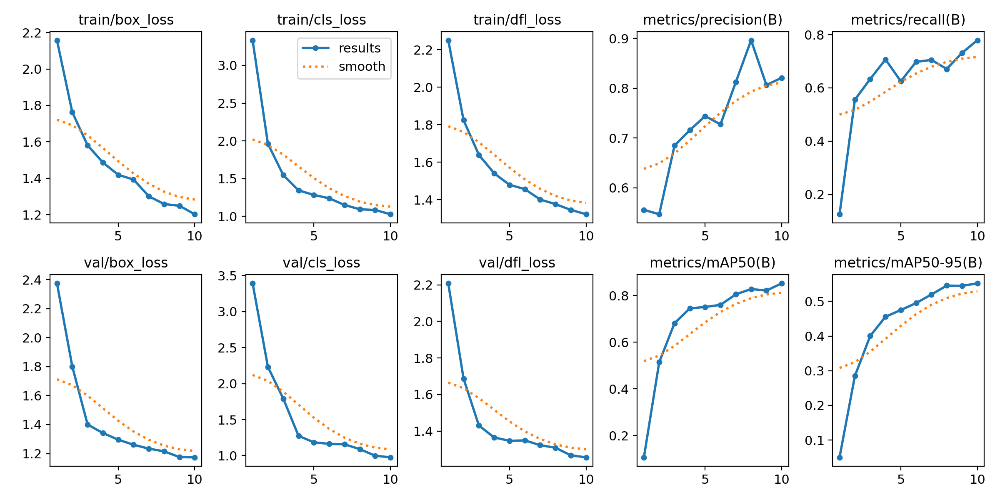

/content/runs/detect/train2/F1_curve.png


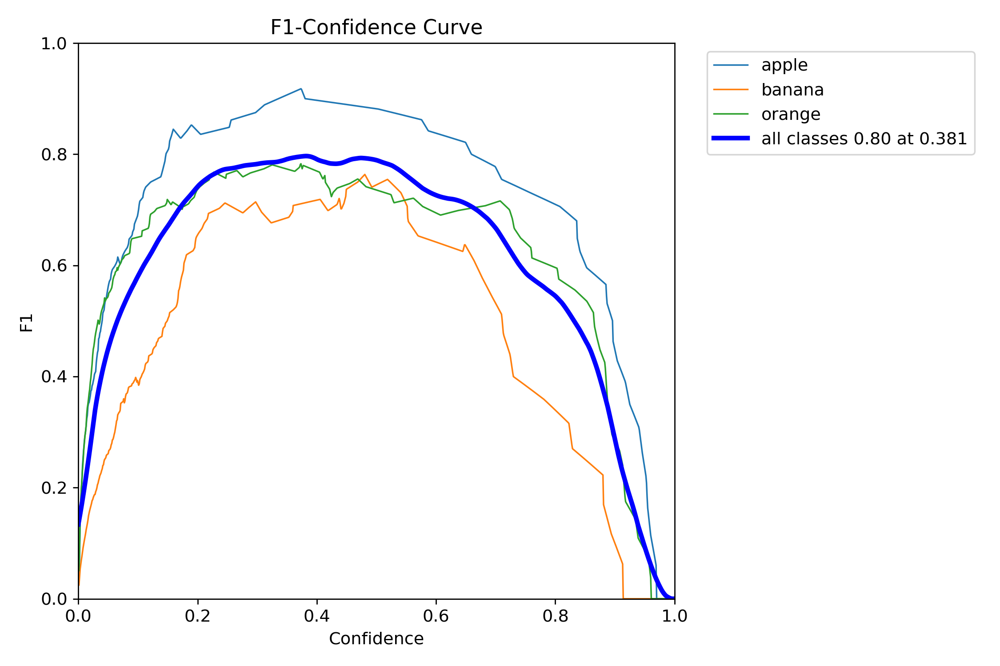

/content/runs/detect/train2/P_curve.png


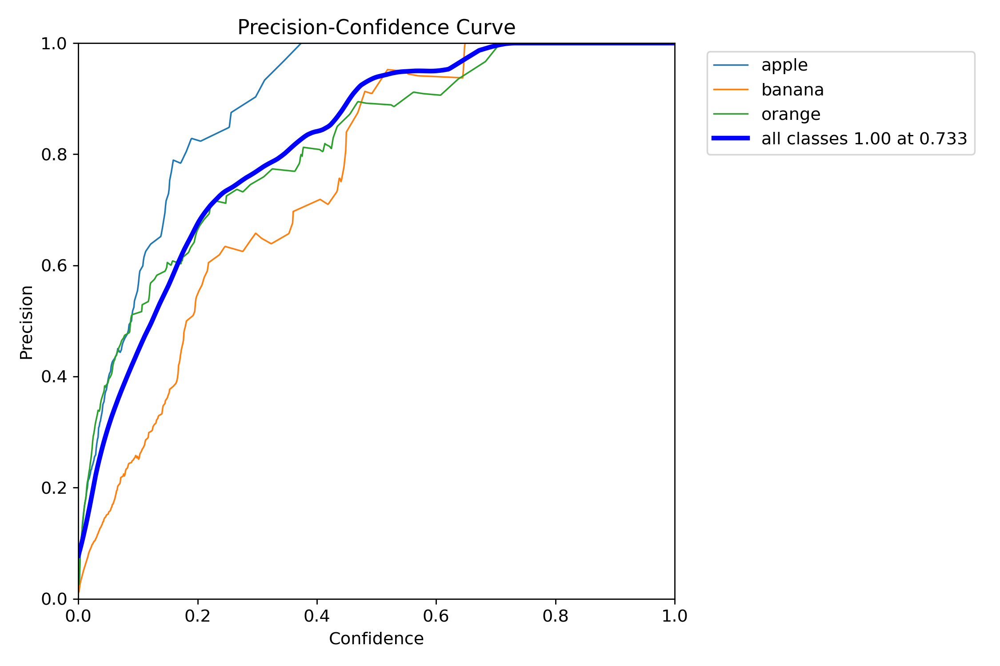

/content/runs/detect/train2/R_curve.png


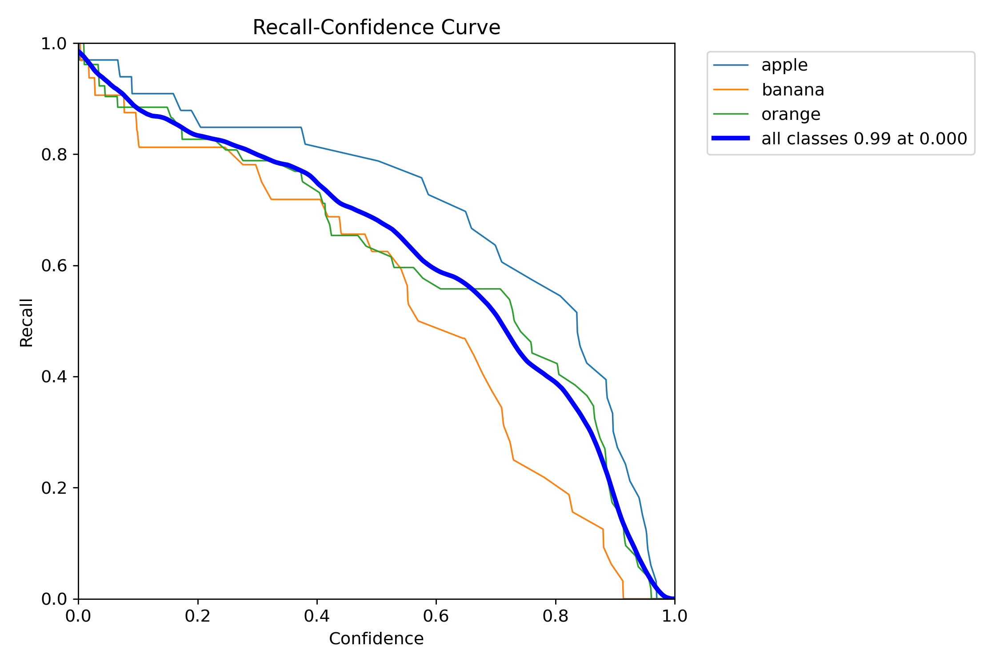

/content/runs/detect/train2/confusion_matrix_normalized.png


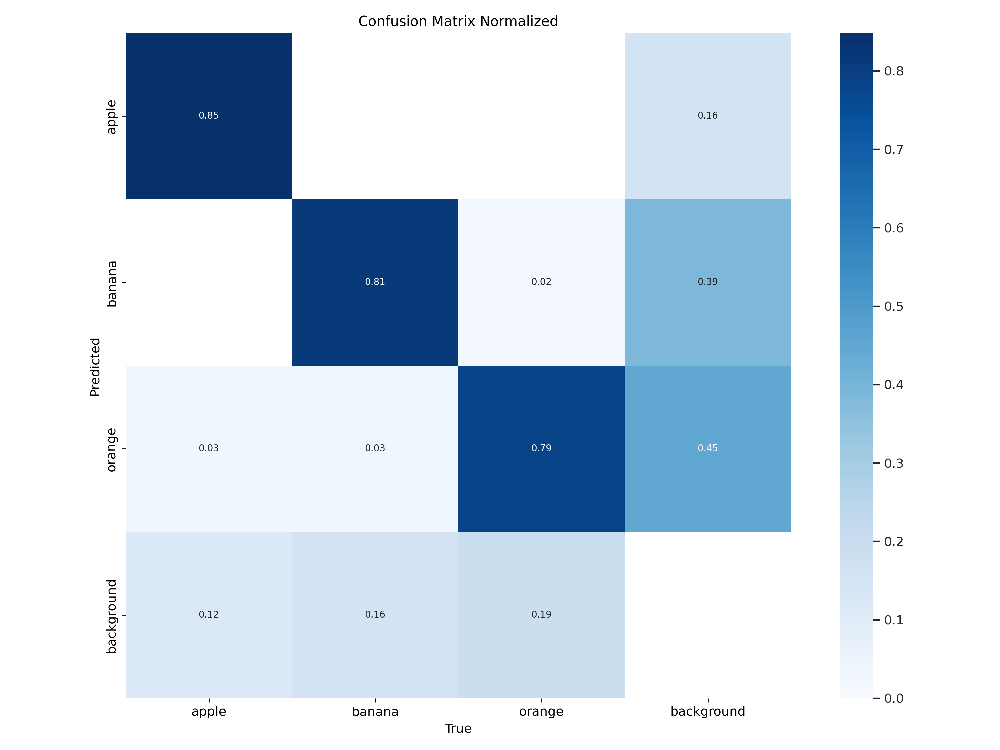

/content/runs/detect/train2/confusion_matrix.png


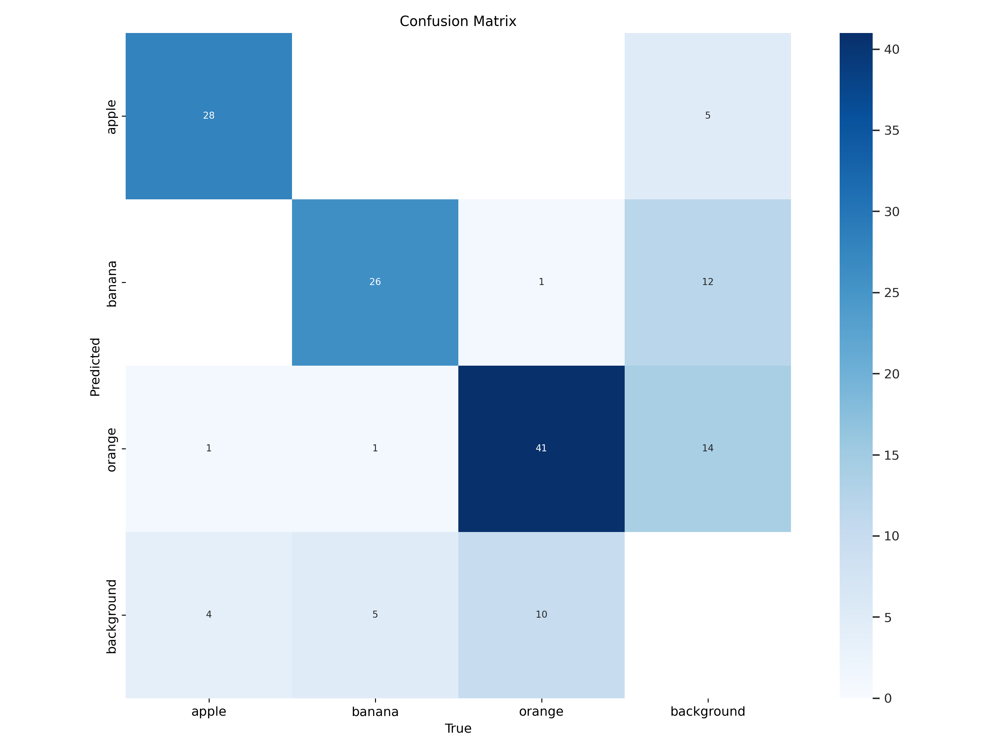

/content/runs/detect/train2/PR_curve.png


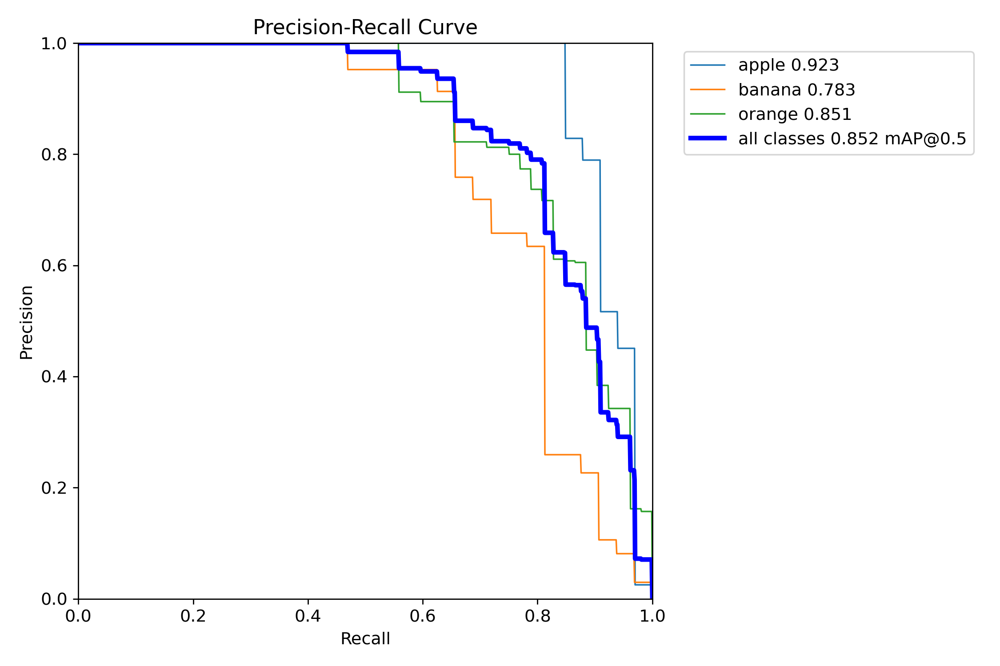

/content/runs/detect/train2/train_batch0.jpg


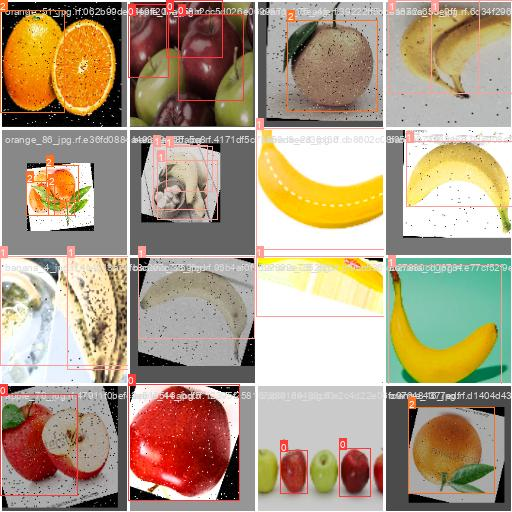

/content/runs/detect/train2/val_batch1_labels.jpg


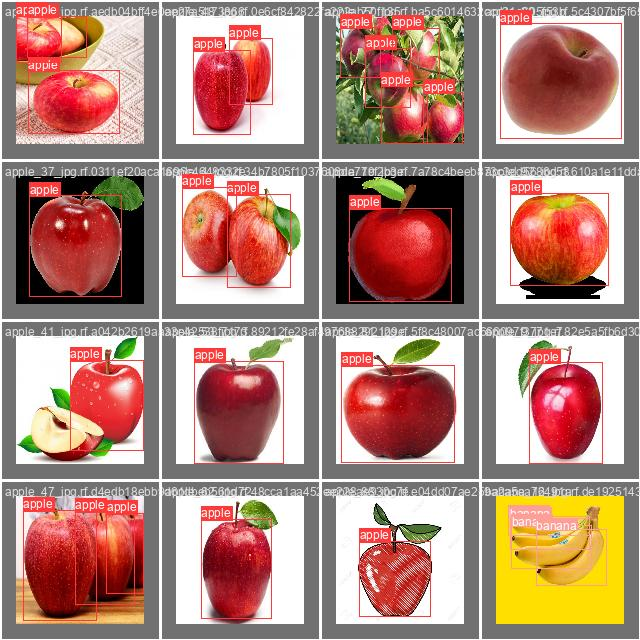

/content/runs/detect/train2/labels_correlogram.jpg


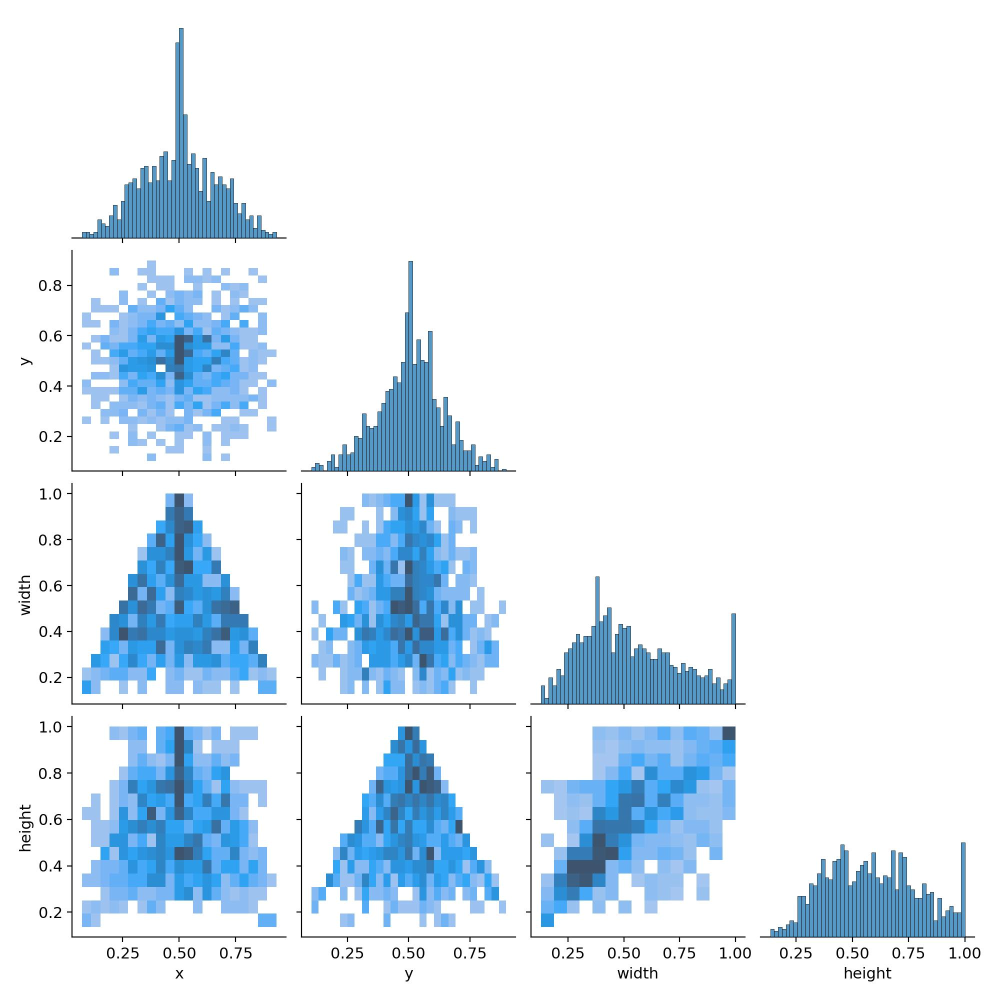

/content/runs/detect/train2/val_batch1_pred.jpg


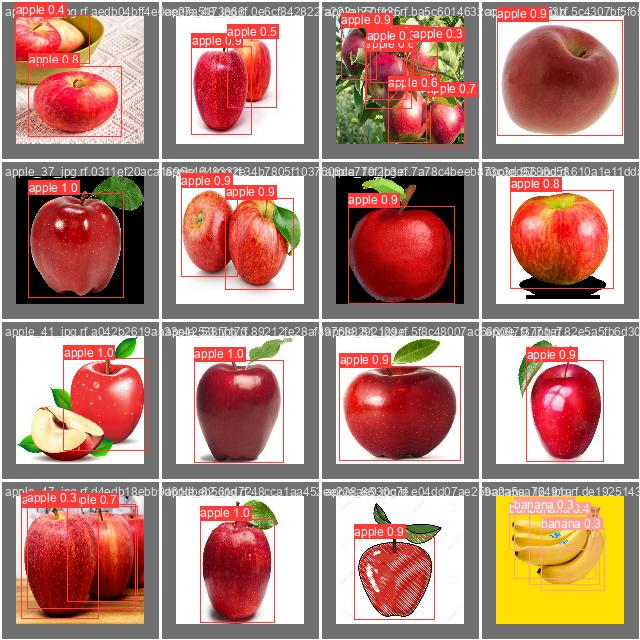

/content/runs/detect/train2/val_batch0_labels.jpg


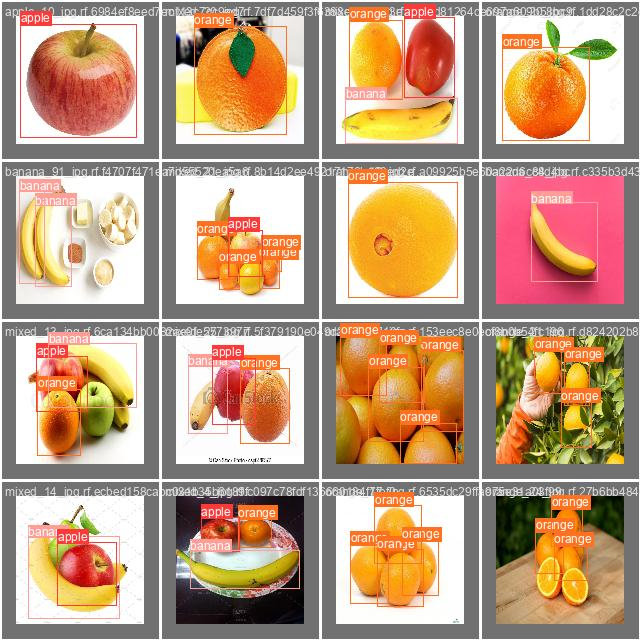

/content/runs/detect/train2/val_batch0_pred.jpg


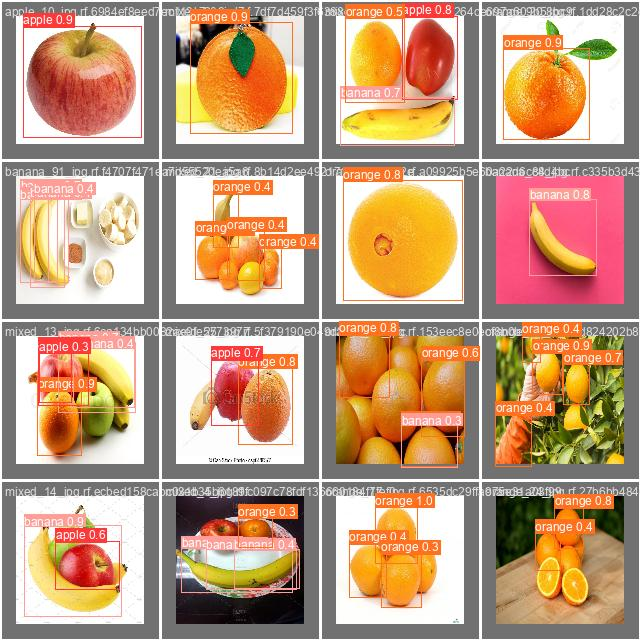

/content/runs/detect/train2/labels.jpg


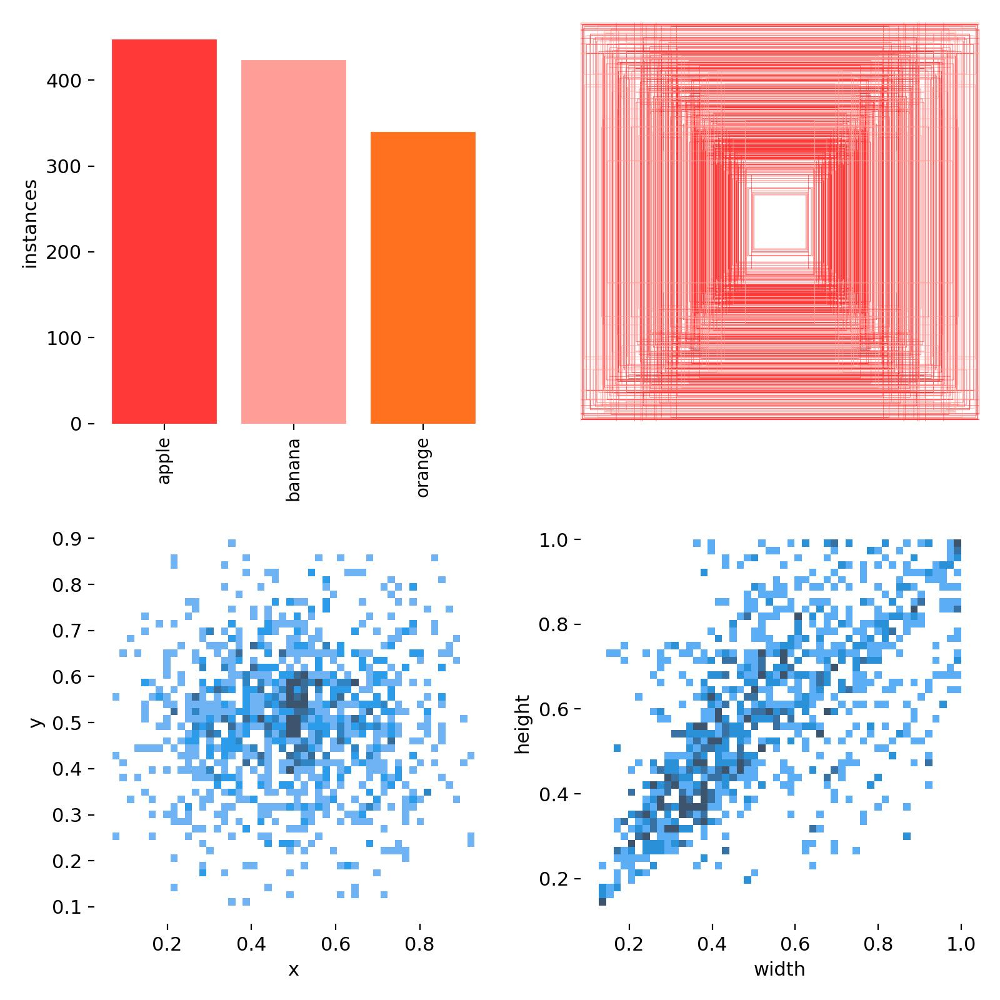

/content/runs/detect/train2/train_batch2.jpg


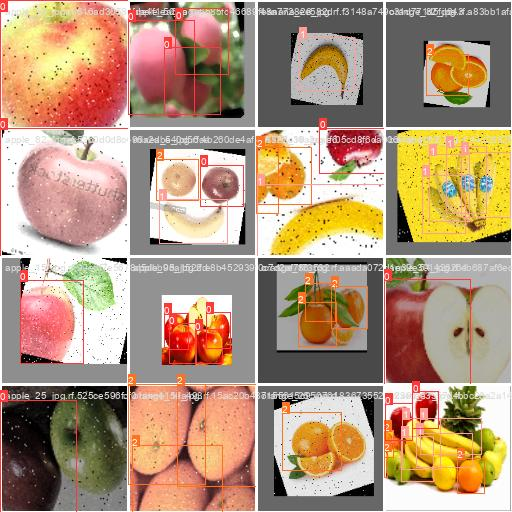

/content/runs/detect/train2/train_batch1.jpg


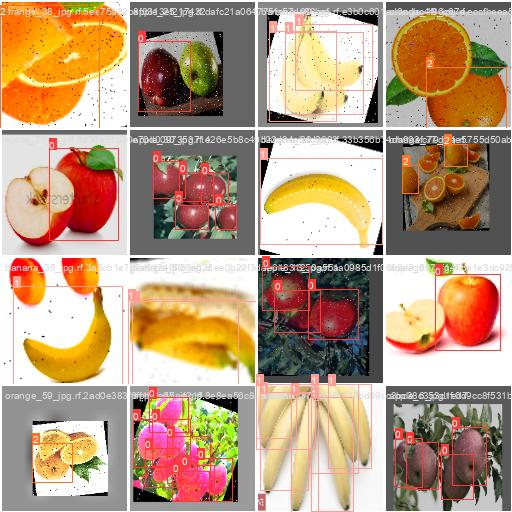

In [ ]:
file_path = glob.glob('/content/runs/detect/train2/*.png')
file_path += glob.glob('/content/runs/detect/train2/*.jpg')
for i in file_path:
  print(i)
  display(Image(filename=i, width=1000))

# test

In [ ]:
test = model.predict("/content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg")


image 1/1 /content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg: 128x128 4 bananas, 15.0ms
Speed: 1.0ms preprocess, 15.0ms inference, 3.0ms postprocess per image at shape (1, 3, 128, 128)


In [ ]:
result = test[0]
box = result.boxes[0]
for box in result.boxes:
  class_id = result.names[box.cls[0].item()]
  cords = box.xyxy[0].tolist()
  cords = [round(x) for x in cords]
  conf = round(box.conf[0].item(), 2)
  print("Object type:", class_id)
  print("Coordinates:", cords)
  print("Probability:", conf)
  print("---")

Object type: banana
Coordinates: [2, 2, 638, 626]
Probability: 0.42
---
Object type: banana
Coordinates: [7, 304, 632, 614]
Probability: 0.4
---
Object type: banana
Coordinates: [228, 127, 639, 366]
Probability: 0.3
---
Object type: banana
Coordinates: [151, 0, 420, 339]
Probability: 0.27
---


In [ ]:
print(result.names)

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

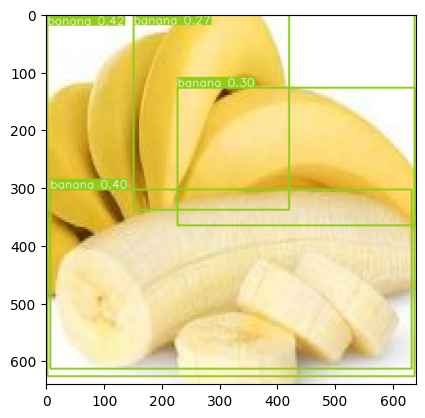

In [ ]:
plt.imshow(result.plot()[:,:,::-1])

# Validation and Prediction from best.pt

In [ ]:
!yolo val model=/content/runs/detect/train2/weights/best.pt data=/content/Fruit_detection-1/data.yaml

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/Fruit_detection-1/valid/labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100% 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 4/4 [00:03<00:00,  1.30it/s]
                   all         60        117       0.82      0.779      0.852      0.554
                 apple         60         33      0.988      0.848      0.923       0.68
                banana         60         32      0.698      0.719      0.783      0.398
                orange         60         52      0.773      0.769      0.851      0.583
Speed: 0.8ms preprocess, 19.7ms inference, 0.0ms loss, 5.7ms postprocess per image
Results saved to runs/detect/val2
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
!yolo predict model=/content/runs/detect/train2/weights/best.pt source=/content/Fruit_detection-1/test/images

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients, 8.1 GFLOPs

image 1/30 /content/Fruit_detection-1/test/images/apple_19_jpg.rf.856015ff1ebb9808038b3508c7b313e9.jpg: 128x128 1 apple, 20.3ms
image 2/30 /content/Fruit_detection-1/test/images/apple_42_jpg.rf.5e2a817429aaa47de10bb5c4687d29cc.jpg: 128x128 1 apple, 6.6ms
image 3/30 /content/Fruit_detection-1/test/images/apple_49_jpg.rf.64d3037fe3b814908ae1ab97cdd8df99.jpg: 128x128 3 apples, 6.3ms
image 4/30 /content/Fruit_detection-1/test/images/apple_58_jpg.rf.2dc0142c93c3a7c26e3fc4bf8d145777.jpg: 128x128 4 apples, 1 banana, 7.2ms
image 5/30 /content/Fruit_detection-1/test/images/apple_66_jpg.rf.15b57db947f3ce046bf4b954eaaea3fc.jpg: 128x128 2 apples, 5.9ms
image 6/30 /content/Fruit_detection-1/test/images/apple_8_jpg.rf.21f6cc267e7401a55ee03152de0e4209.jpg: 128x128 1 apple, 5.7ms
image 7/30 /content/Fruit_detection-1/test/images/banana_

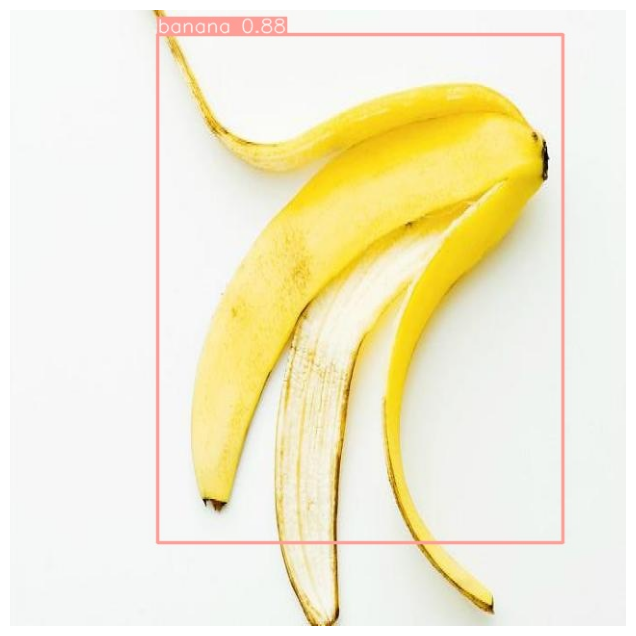

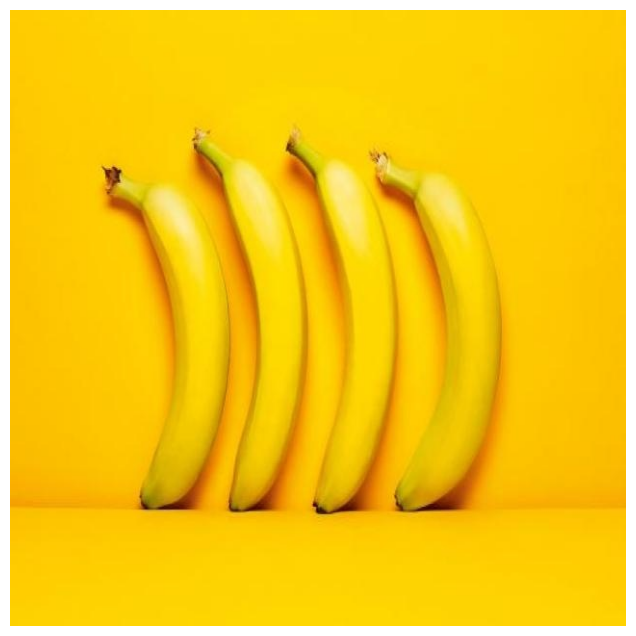

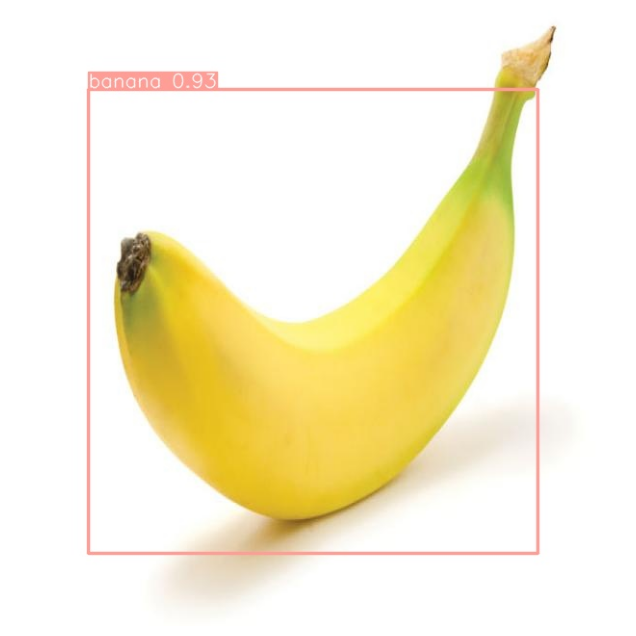

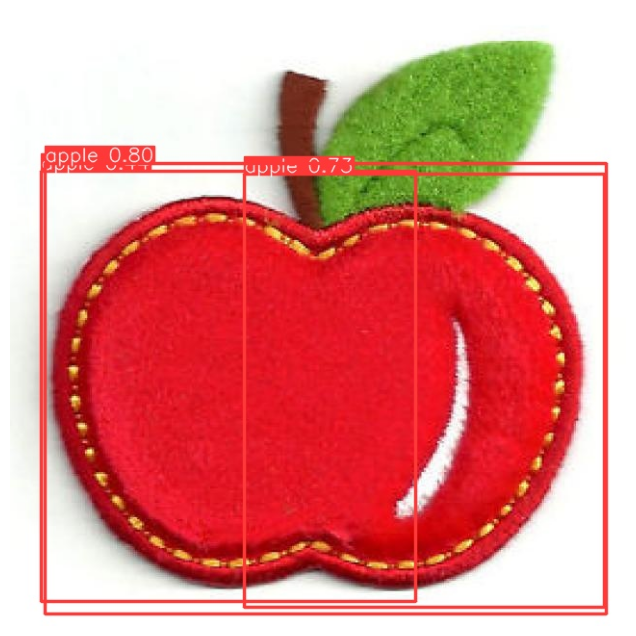

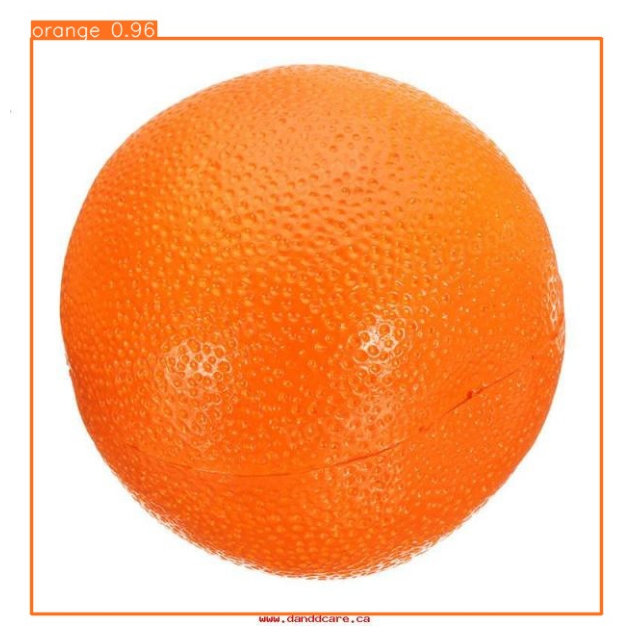

...

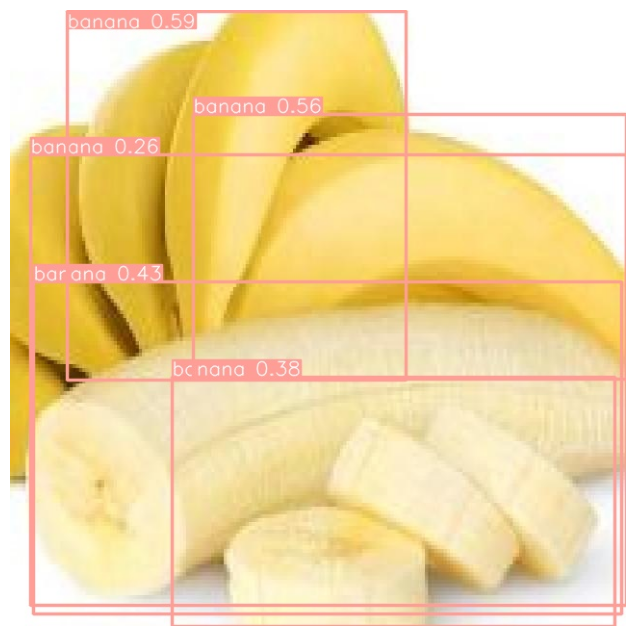

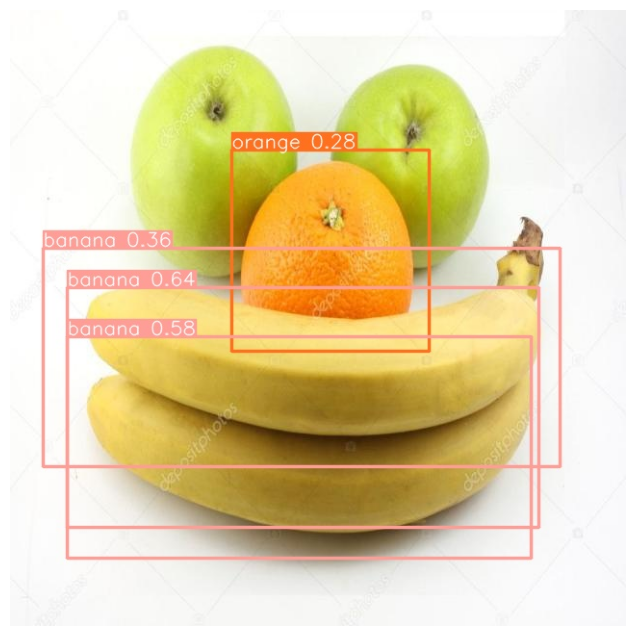

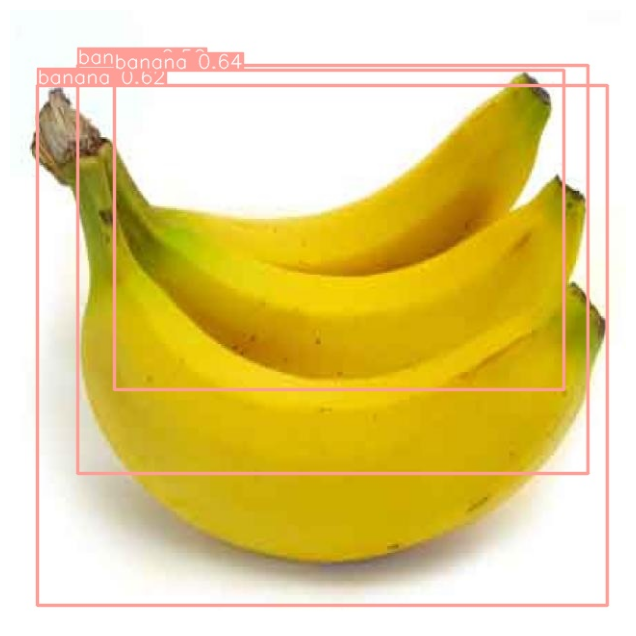

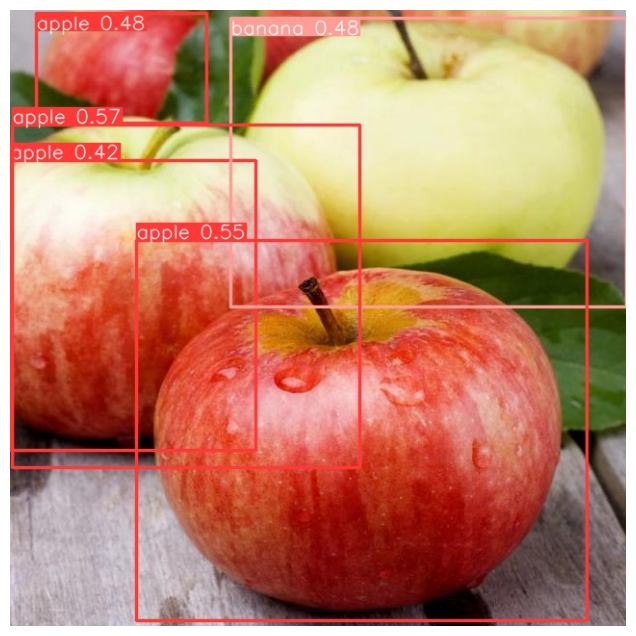

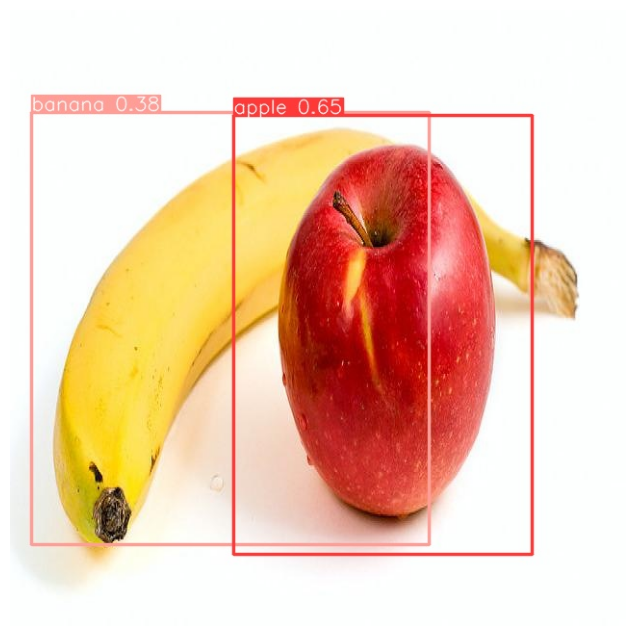

In [ ]:
pred = glob.glob('/content/runs/detect/predict2/*.jpg')
for num in range(len(pred)):
  plt.figure(figsize=(8, 8))
  img = mpimg.imread(pred[num])
  # plt.subplot(6,5,num+1)
  plt.imshow(img)
  plt.axis('off')
  plt.show()

# Train From New Model

In [ ]:
# Load a model
new_model = YOLO('yolov8n.yaml')  # build a new model from YAML


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

In [ ]:
# Train the model
results = new_model.train(data='/content/Fruit_detection-1/data.yaml', epochs=10, imgsz=640)

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/Fruit_detection-1/data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, kera

/content/runs/detect/train3/results.png


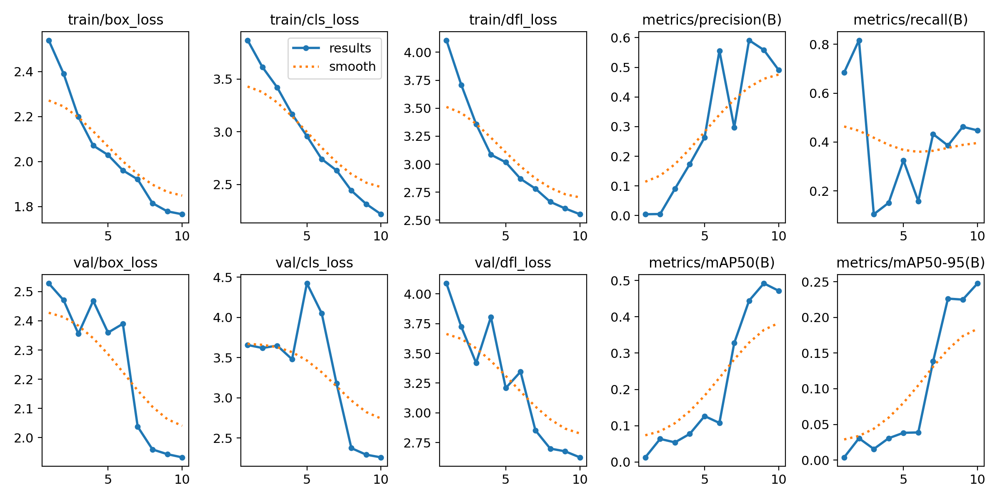

/content/runs/detect/train3/F1_curve.png


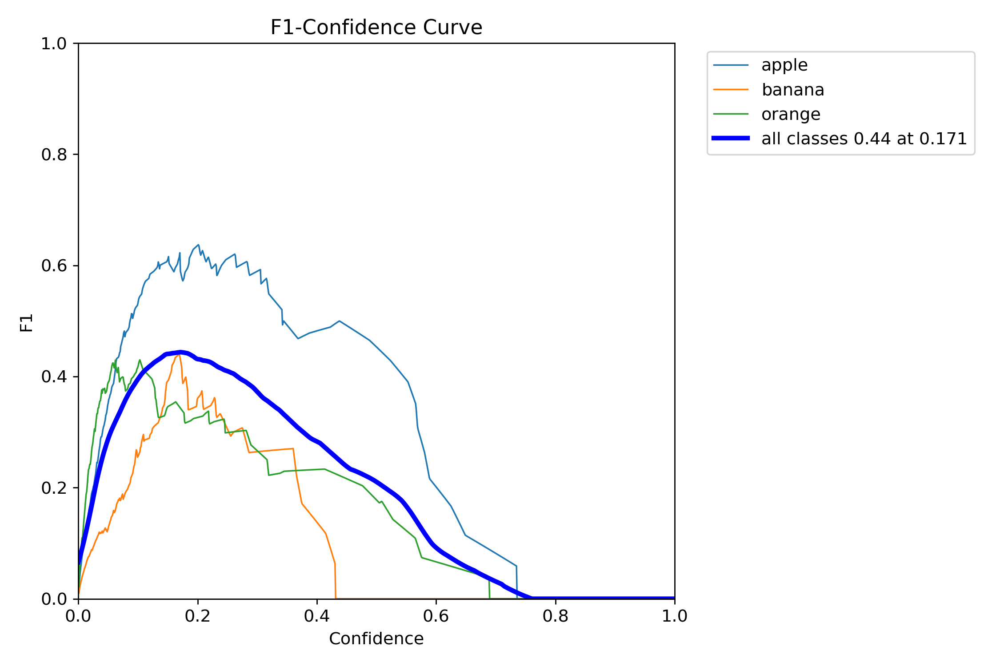

/content/runs/detect/train3/P_curve.png


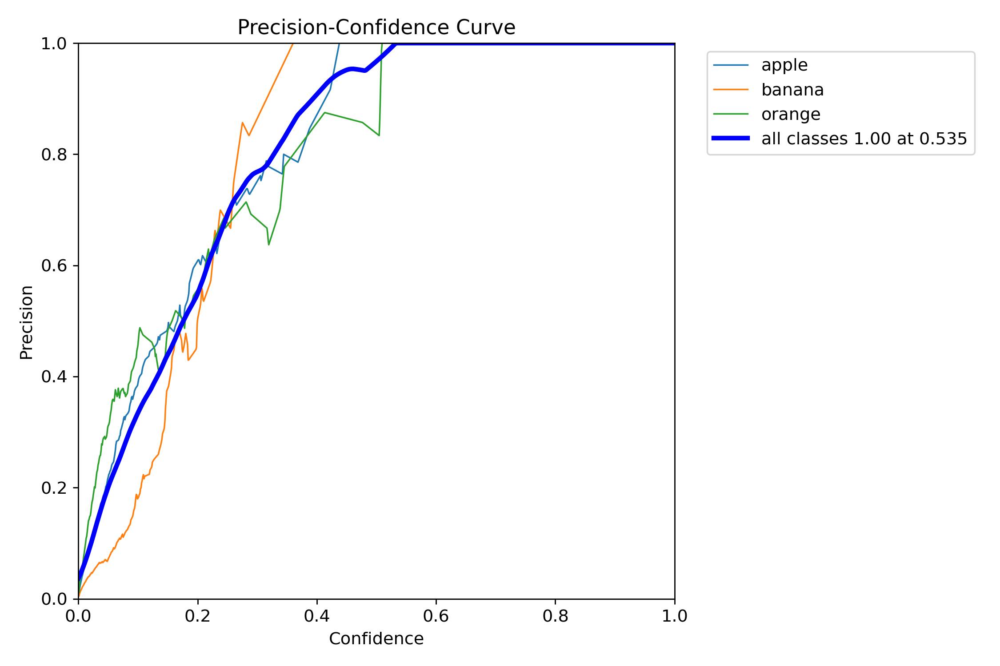

/content/runs/detect/train3/R_curve.png


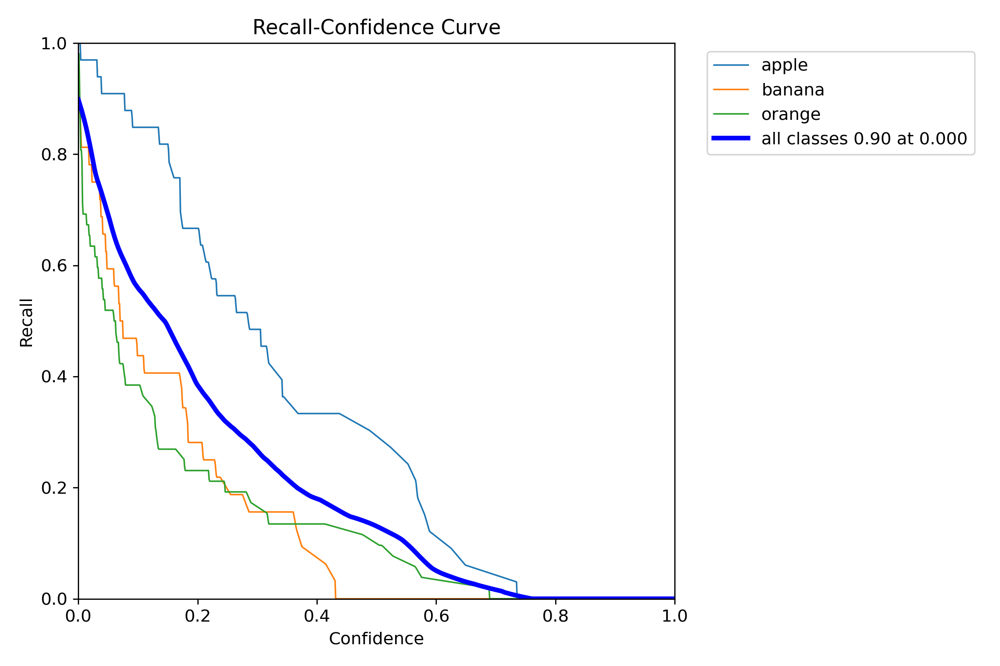

/content/runs/detect/train3/confusion_matrix_normalized.png


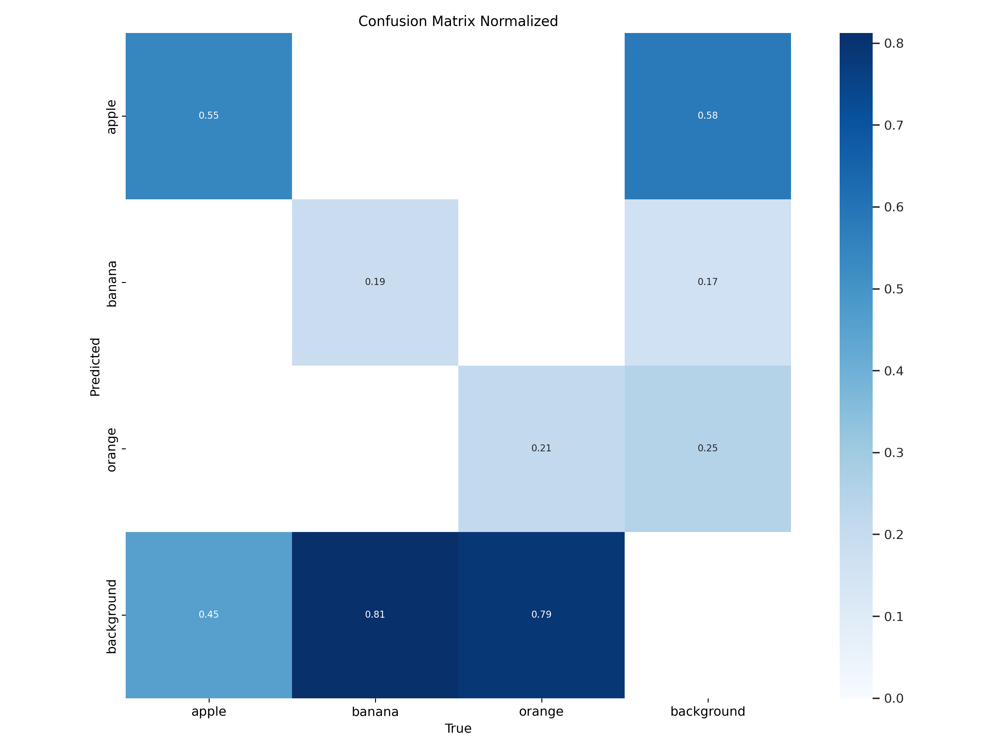

/content/runs/detect/train3/confusion_matrix.png


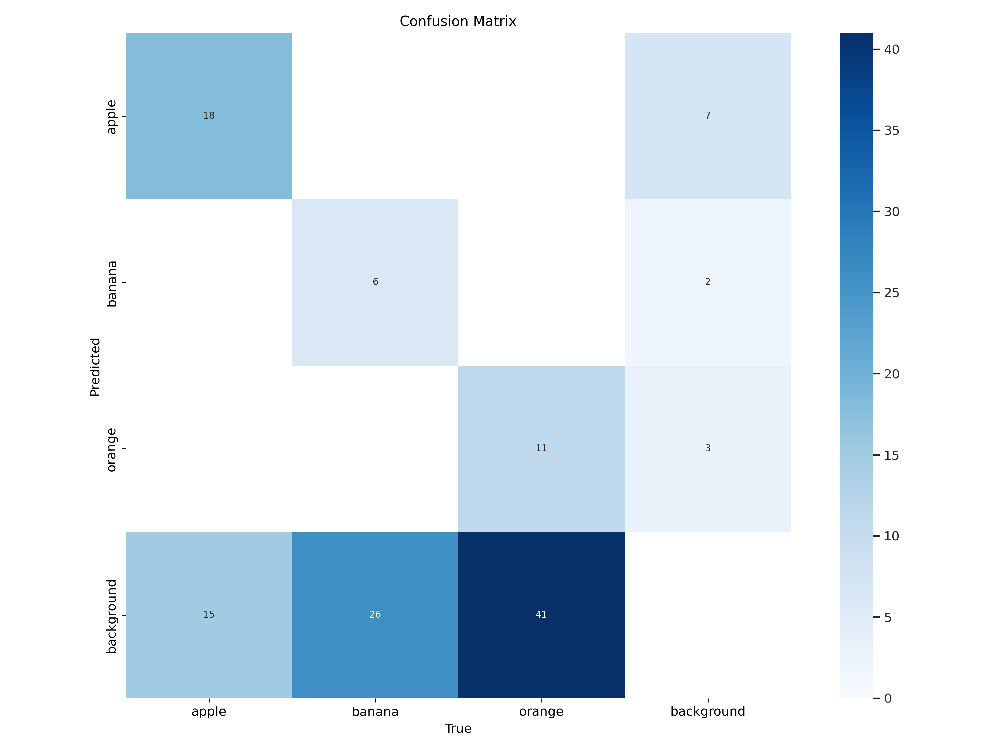

/content/runs/detect/train3/PR_curve.png


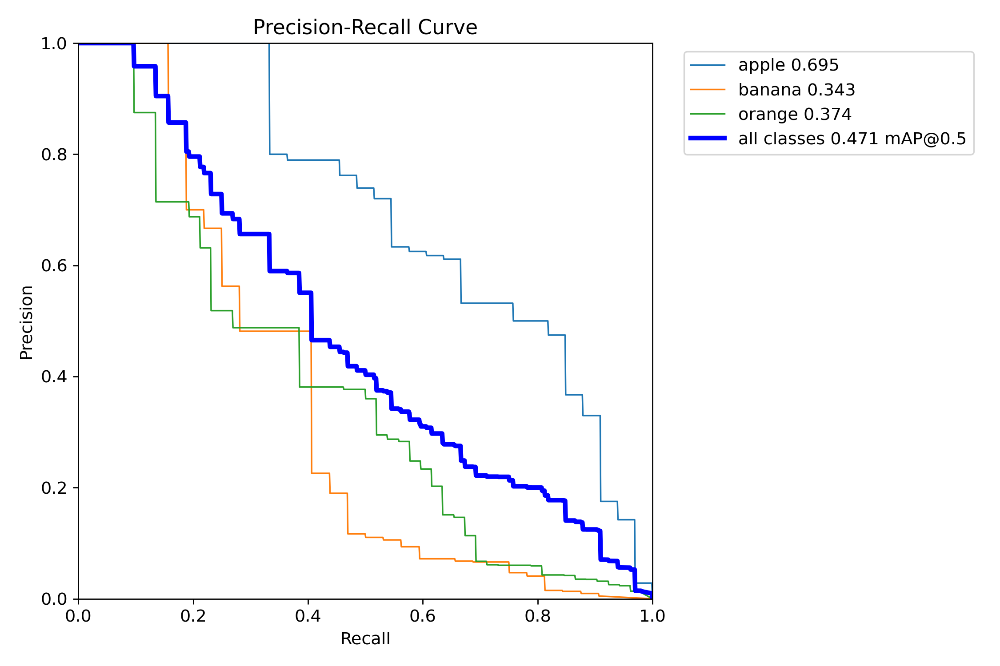

/content/runs/detect/train3/train_batch0.jpg


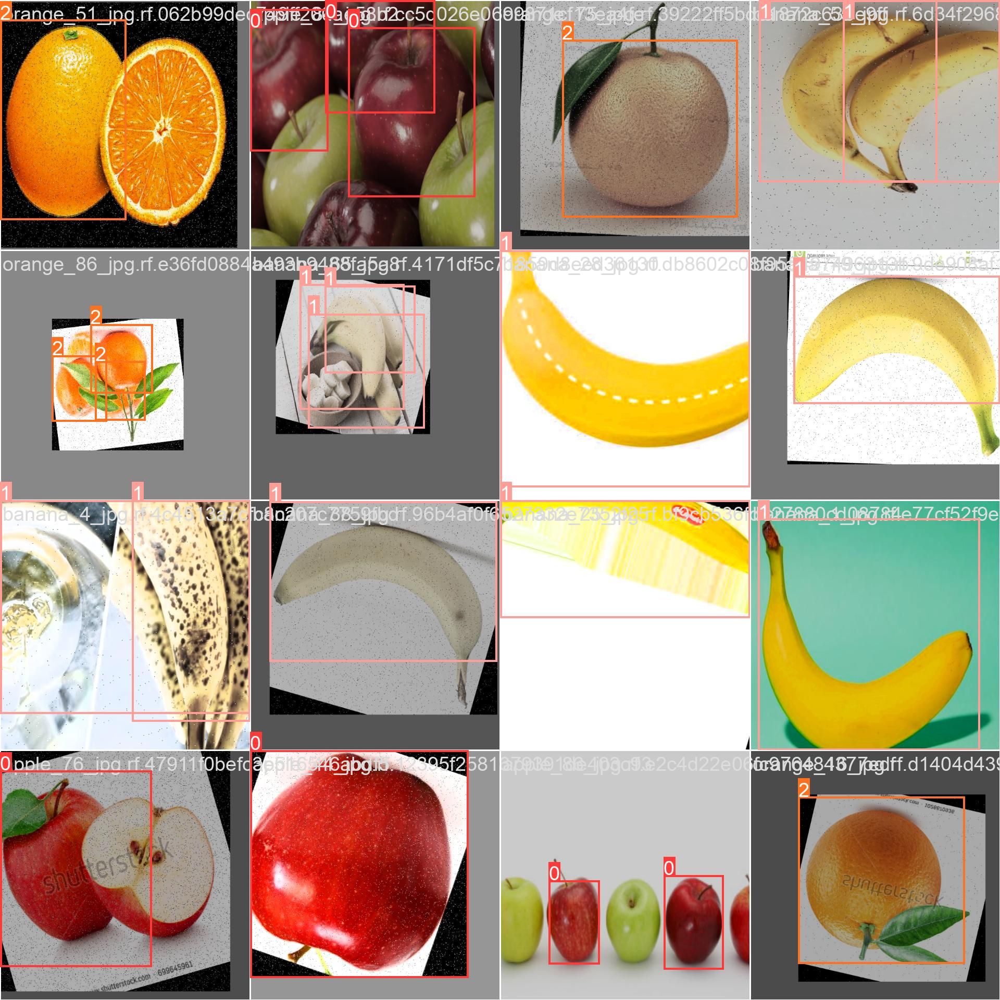

/content/runs/detect/train3/val_batch1_labels.jpg


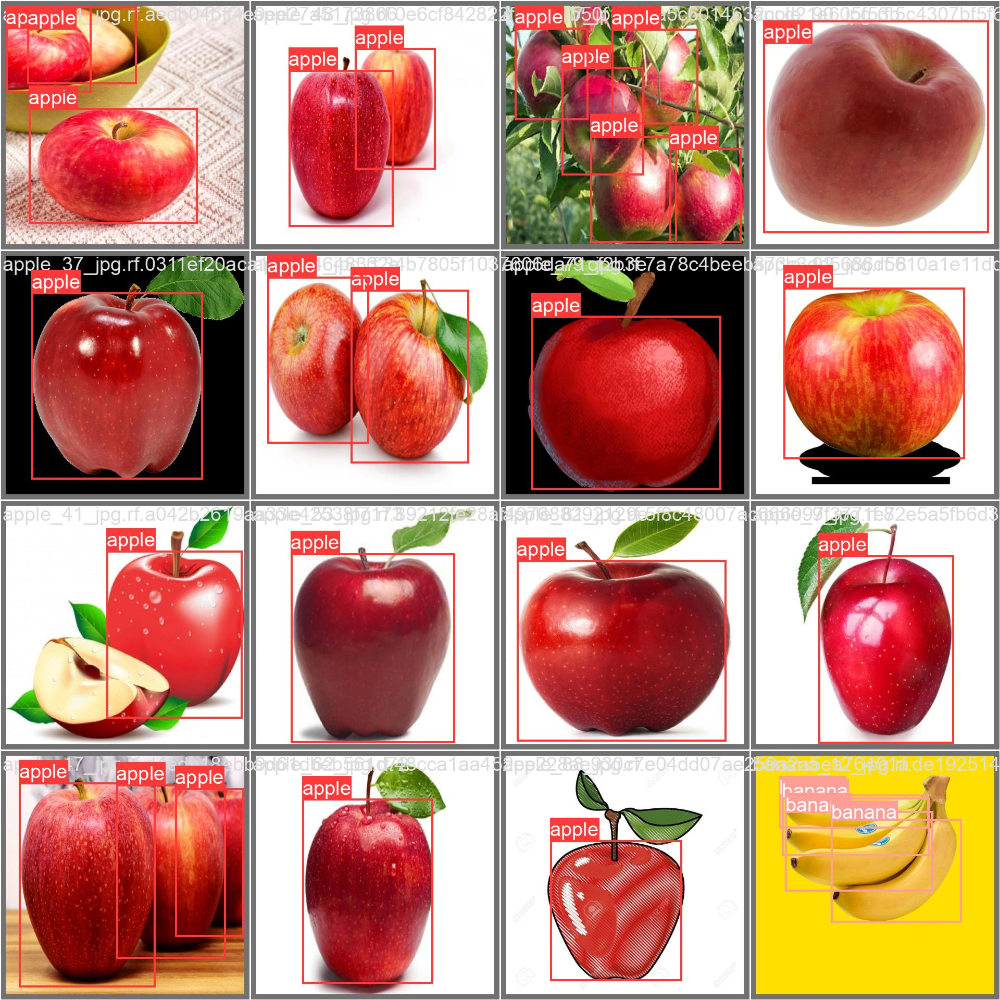

/content/runs/detect/train3/labels_correlogram.jpg


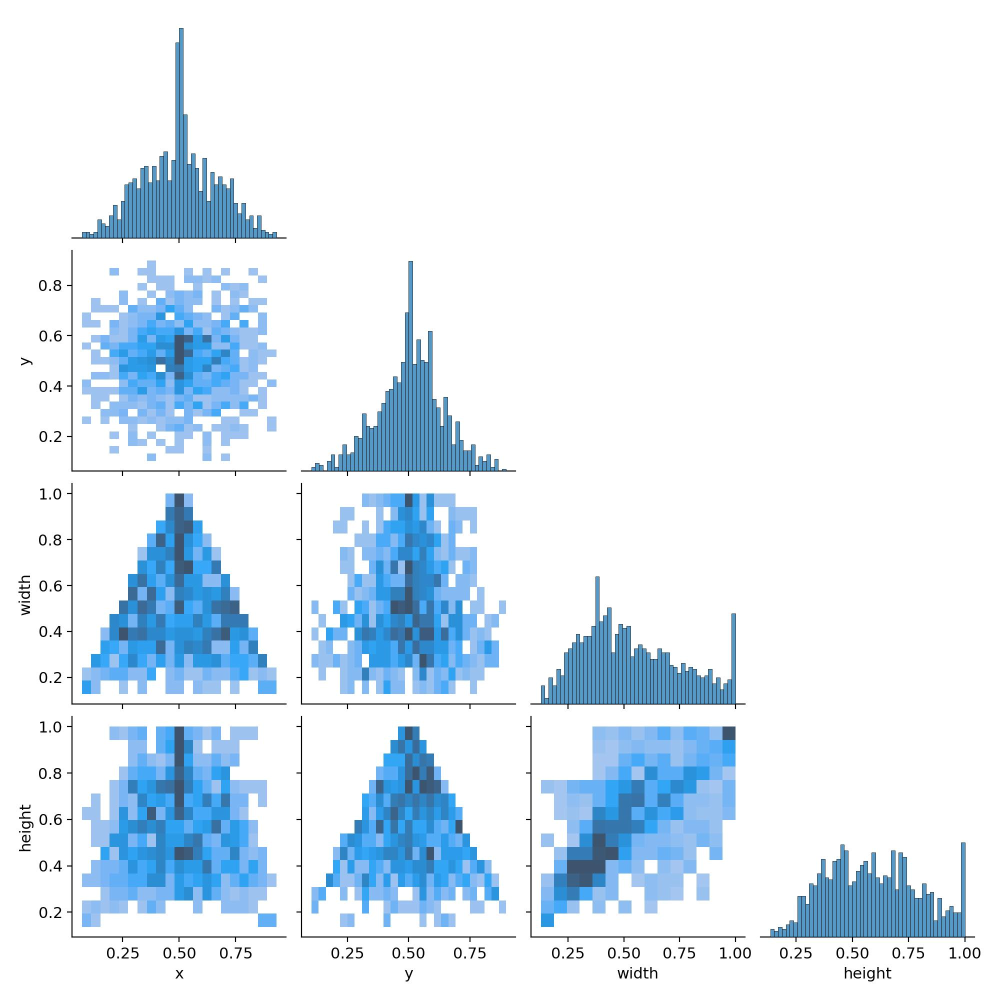

/content/runs/detect/train3/val_batch1_pred.jpg


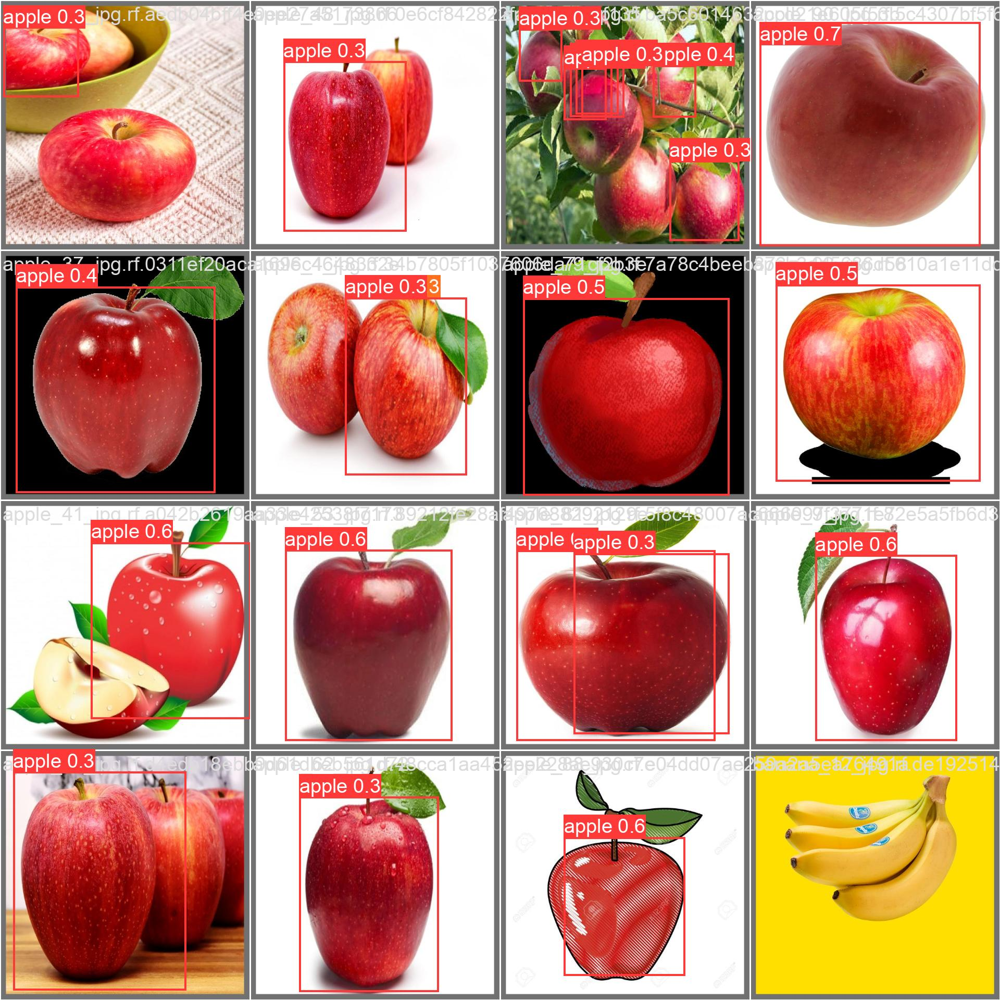

/content/runs/detect/train3/val_batch0_labels.jpg


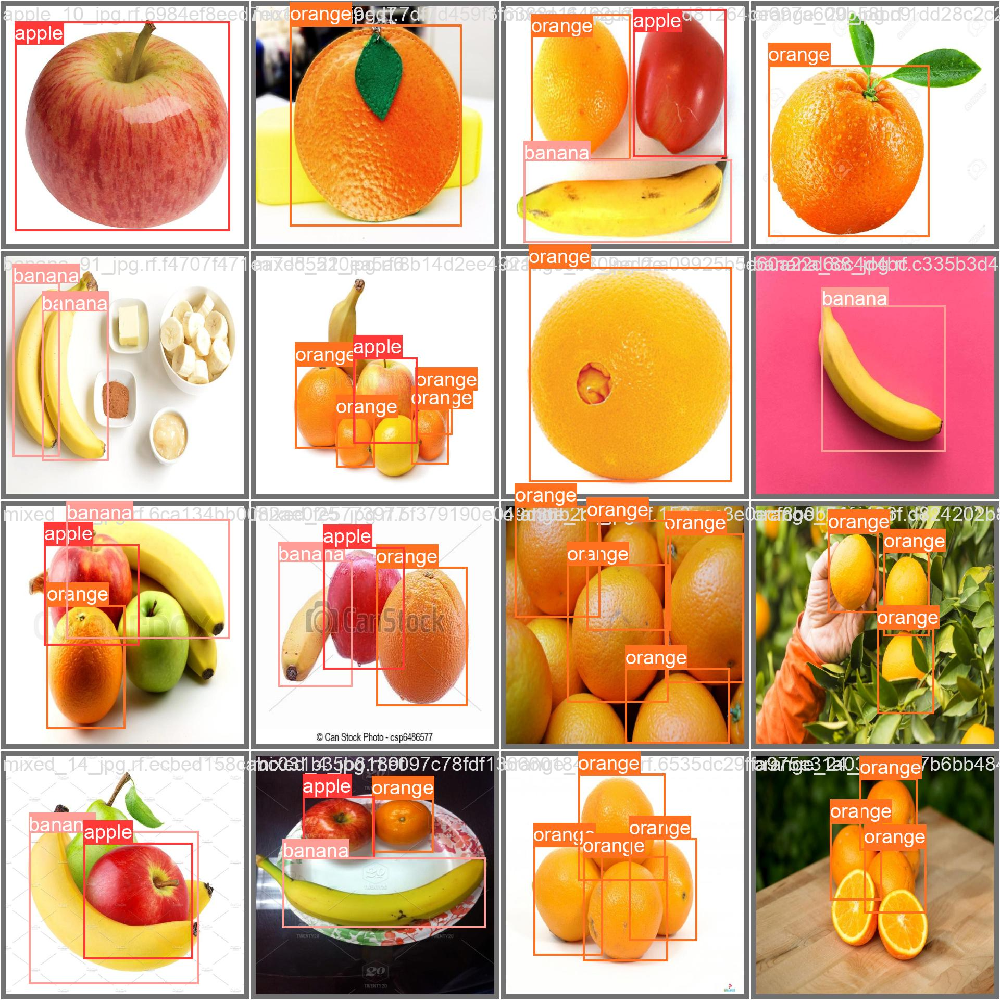

/content/runs/detect/train3/val_batch0_pred.jpg


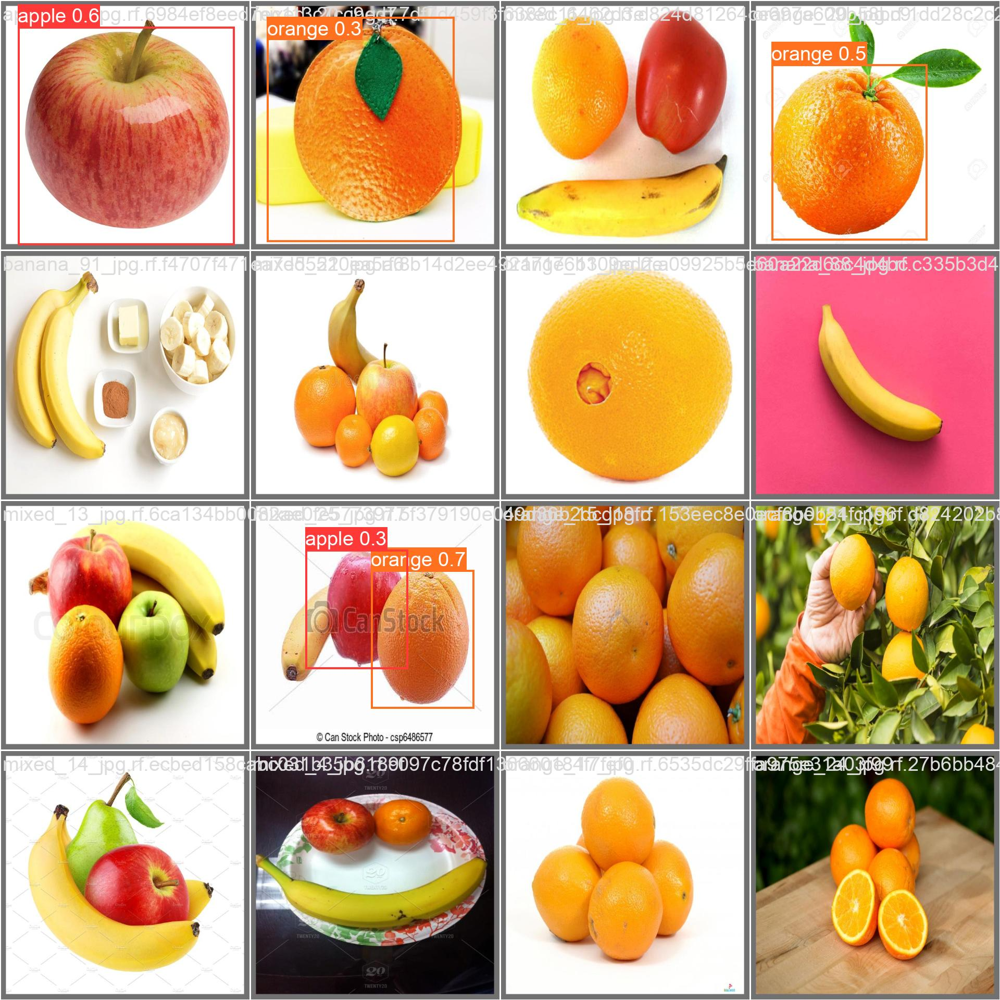

/content/runs/detect/train3/labels.jpg


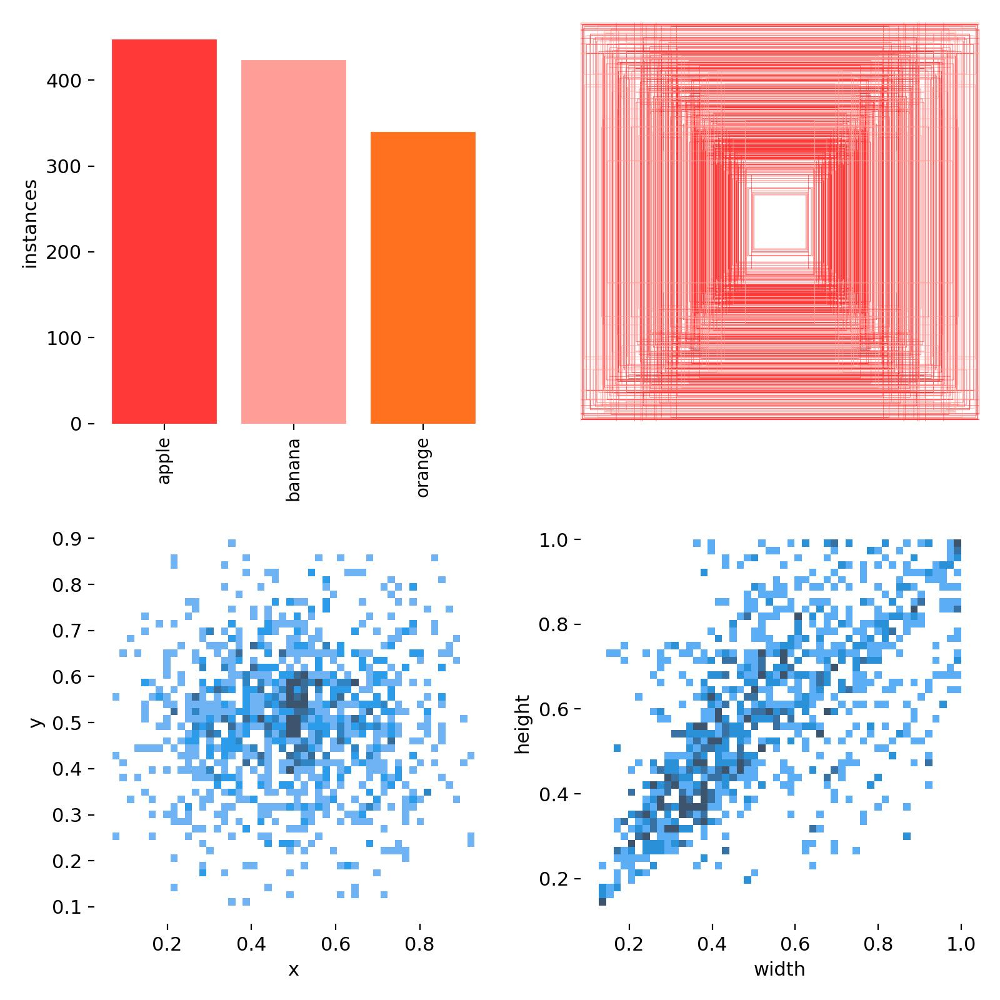

/content/runs/detect/train3/train_batch2.jpg


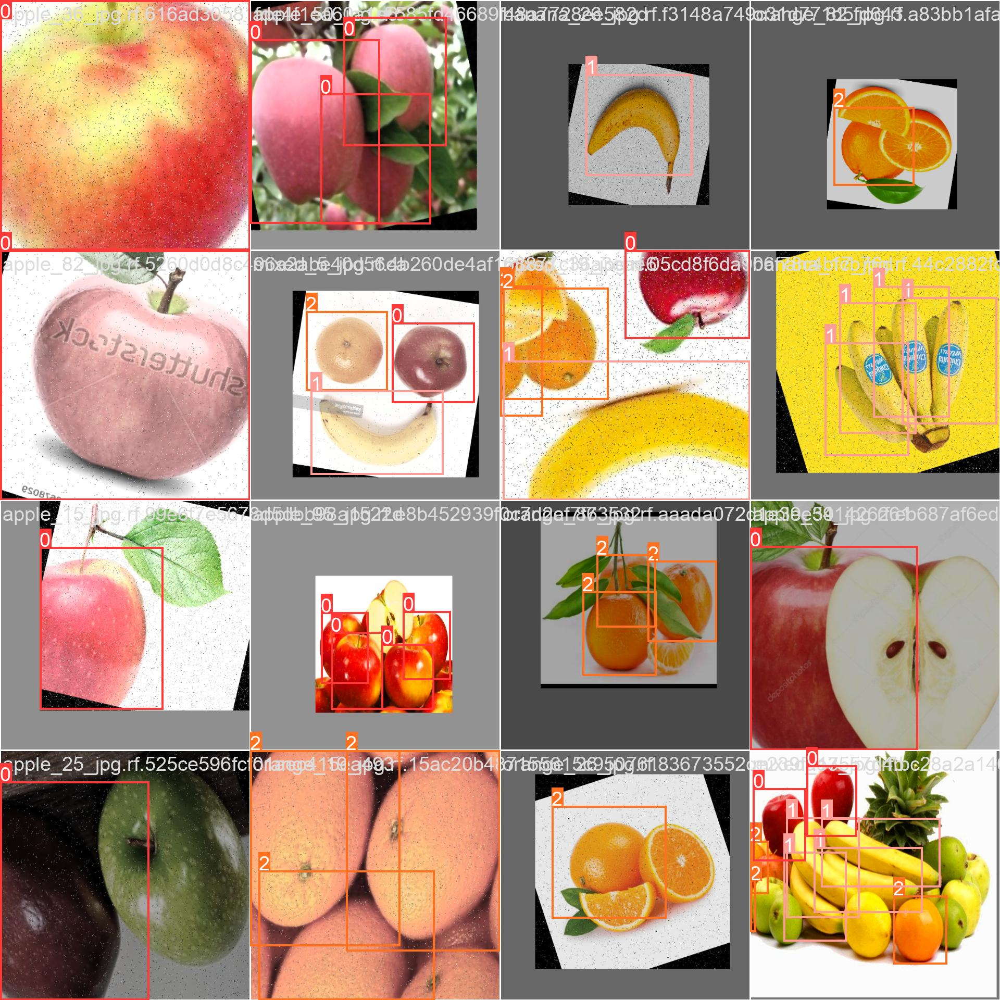

/content/runs/detect/train3/train_batch1.jpg


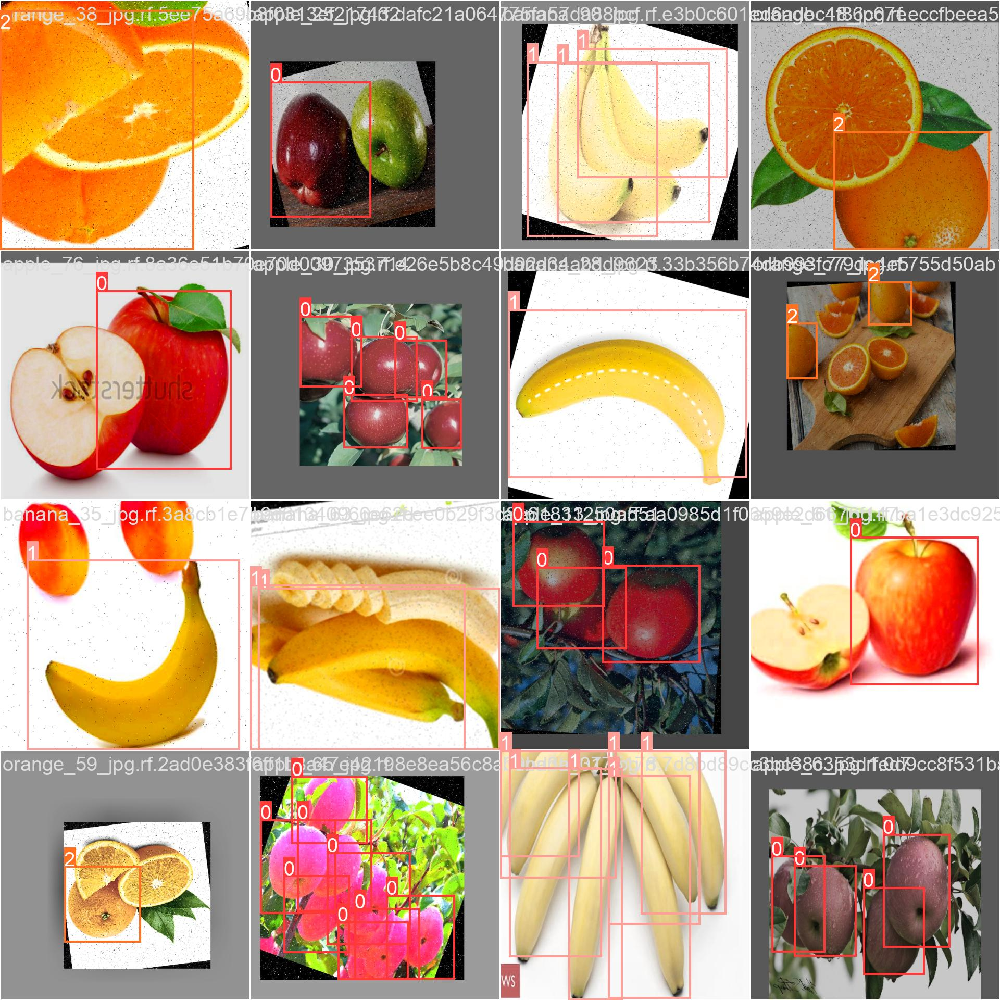

In [ ]:
file_path = glob.glob('/content/runs/detect/train3/*.png')
file_path += glob.glob('/content/runs/detect/train3/*.jpg')
for i in file_path:
  print(i)
  display(Image(filename=i, width=1000))

In [ ]:
print(results.names)

{0: 'apple', 1: 'banana', 2: 'orange'}


In [ ]:
test2 = new_model.predict("/content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg")
result = test2[0]
box = result.boxes[0]
for box in result.boxes:
  class_id = result.names[box.cls[0].item()]
  cords = box.xyxy[0].tolist()
  cords = [round(x) for x in cords]
  conf = round(box.conf[0].item(), 2)
  print("Object type:", class_id)
  print("Coordinates:", cords)
  print("Probability:", conf)
  print("---")


image 1/1 /content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg: 640x640 1 orange, 15.4ms
Speed: 2.0ms preprocess, 15.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


Object type: orange
Coordinates: [8, 11, 604, 637]
Probability: 0.37
---


In [ ]:
print(result.names)

{0: 'apple', 1: 'banana', 2: 'orange'}


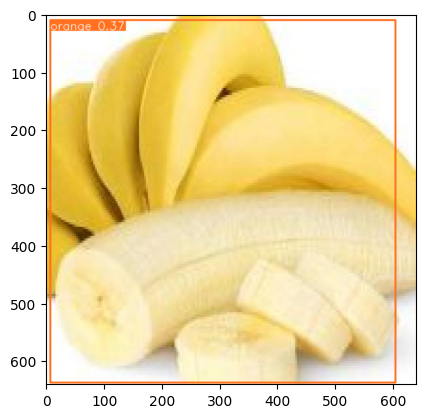

In [ ]:
plt.imshow(result.plot()[:,:,::-1])

# \#TAKE 2 100 epochs 10 patience

In [ ]:
# Load a model
new_model_2 = YOLO('yolov8n.yaml')  # build a new model from YAML
# Train the model
results2 = new_model_2.train(data='/content/Fruit_detection-1/data.yaml', epochs=100, patience=10, imgsz=640)


                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

/content/runs/detect/train4/results.png


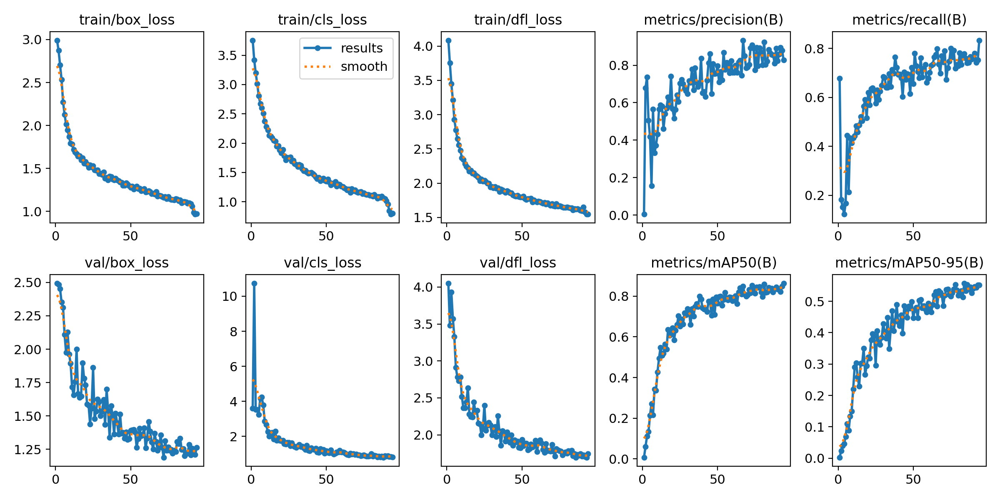

/content/runs/detect/train4/F1_curve.png


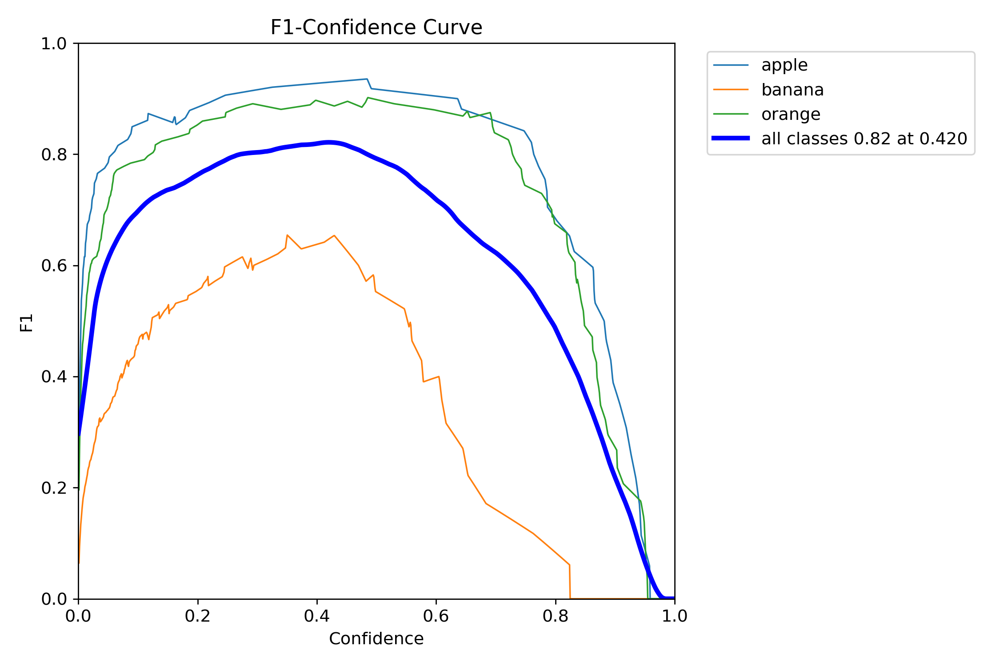

/content/runs/detect/train4/P_curve.png


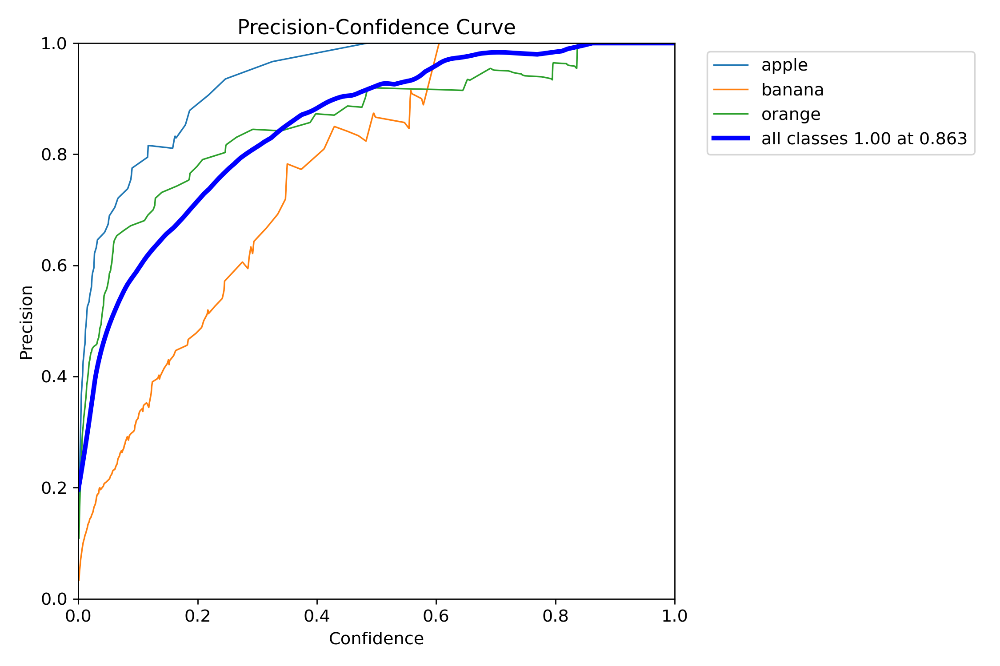

/content/runs/detect/train4/R_curve.png


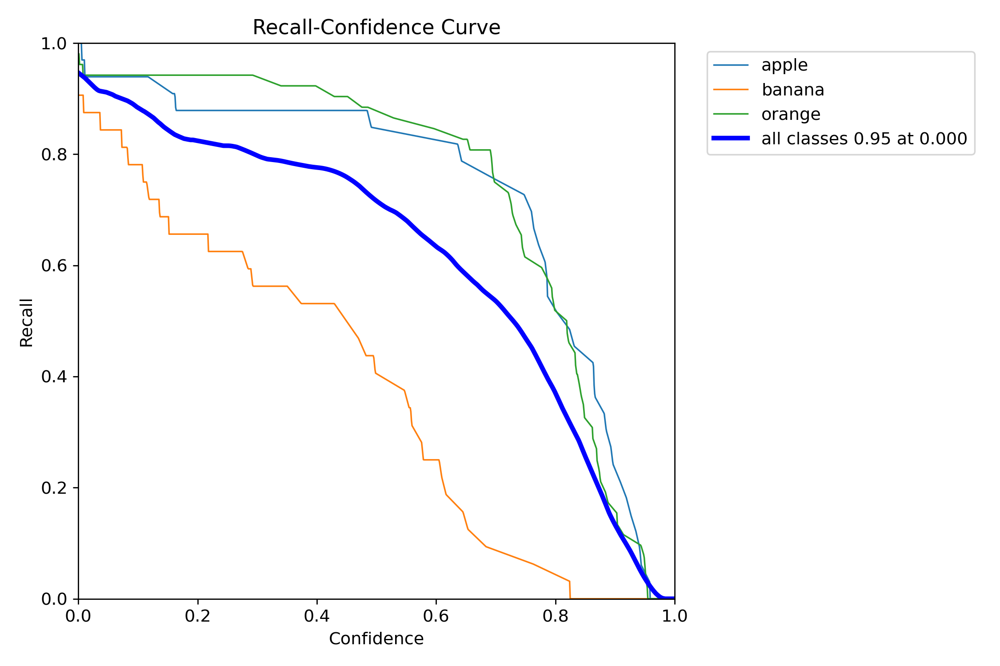

/content/runs/detect/train4/confusion_matrix_normalized.png


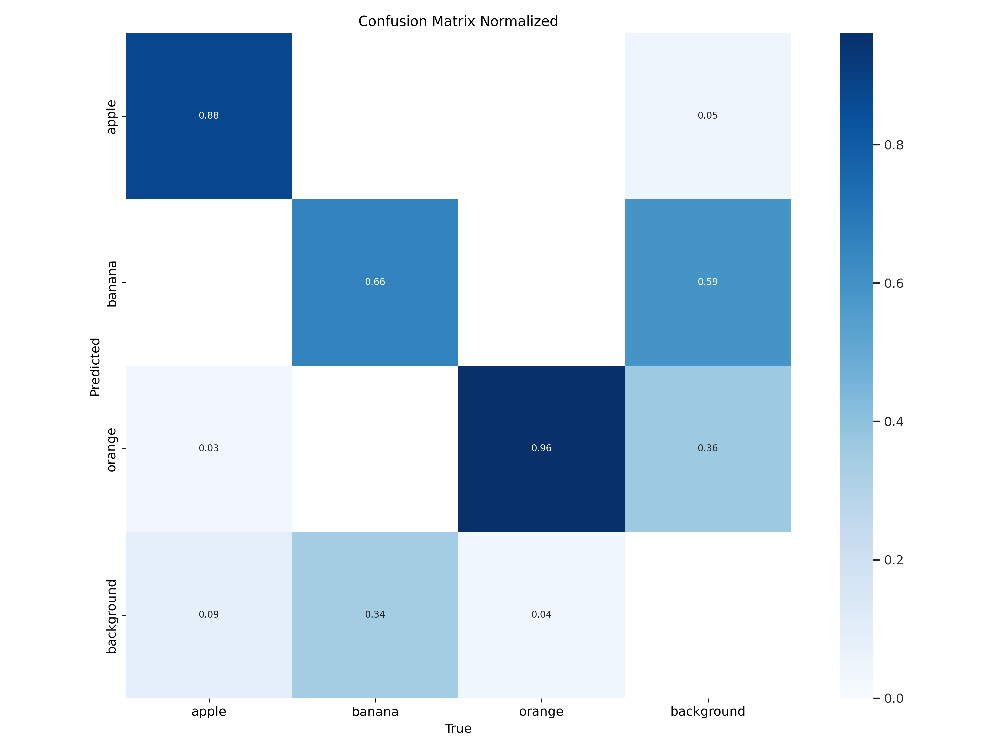

/content/runs/detect/train4/confusion_matrix.png


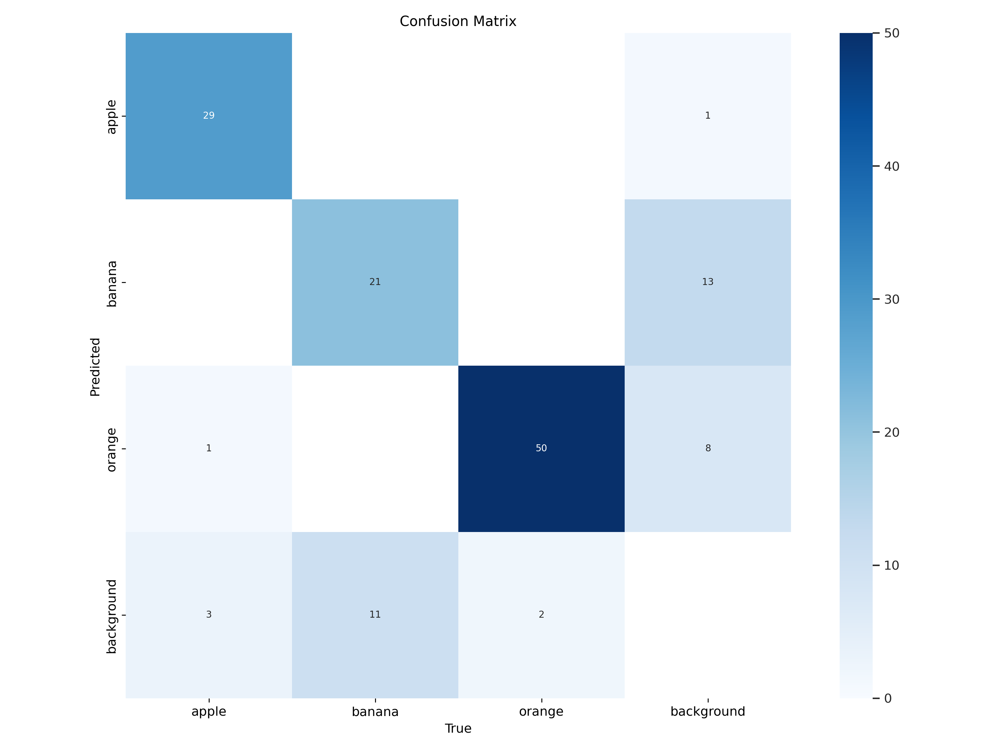

/content/runs/detect/train4/PR_curve.png


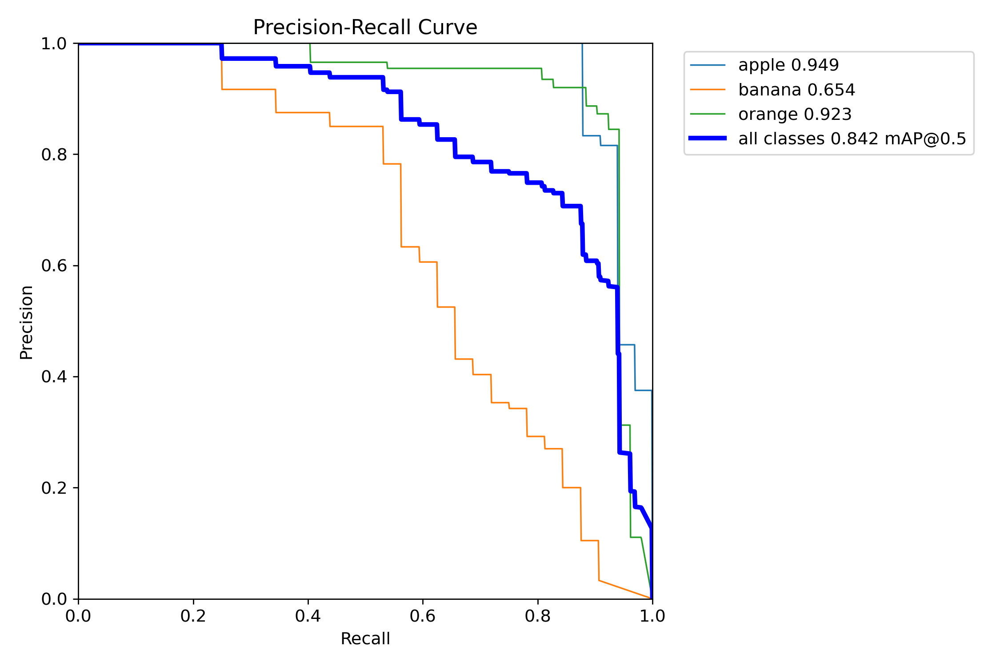

/content/runs/detect/train4/train_batch3601.jpg


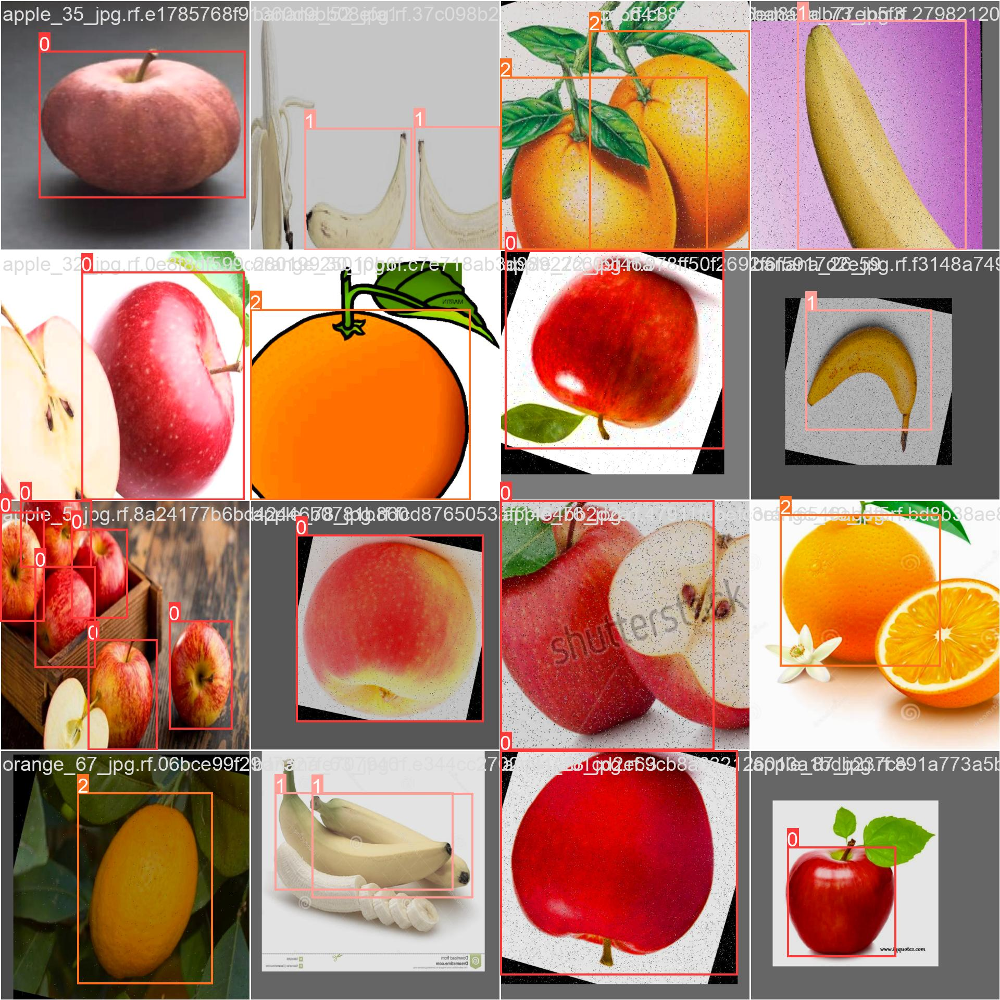

/content/runs/detect/train4/train_batch0.jpg


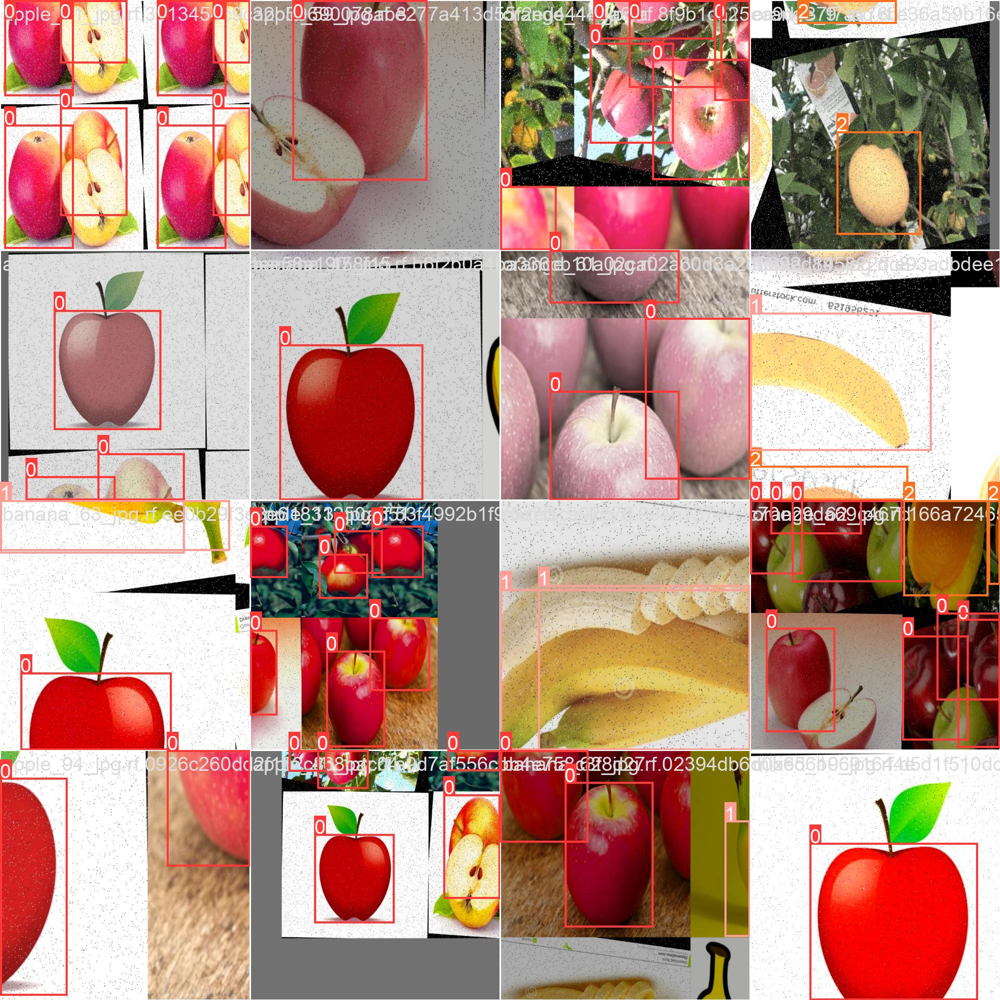

/content/runs/detect/train4/val_batch1_labels.jpg


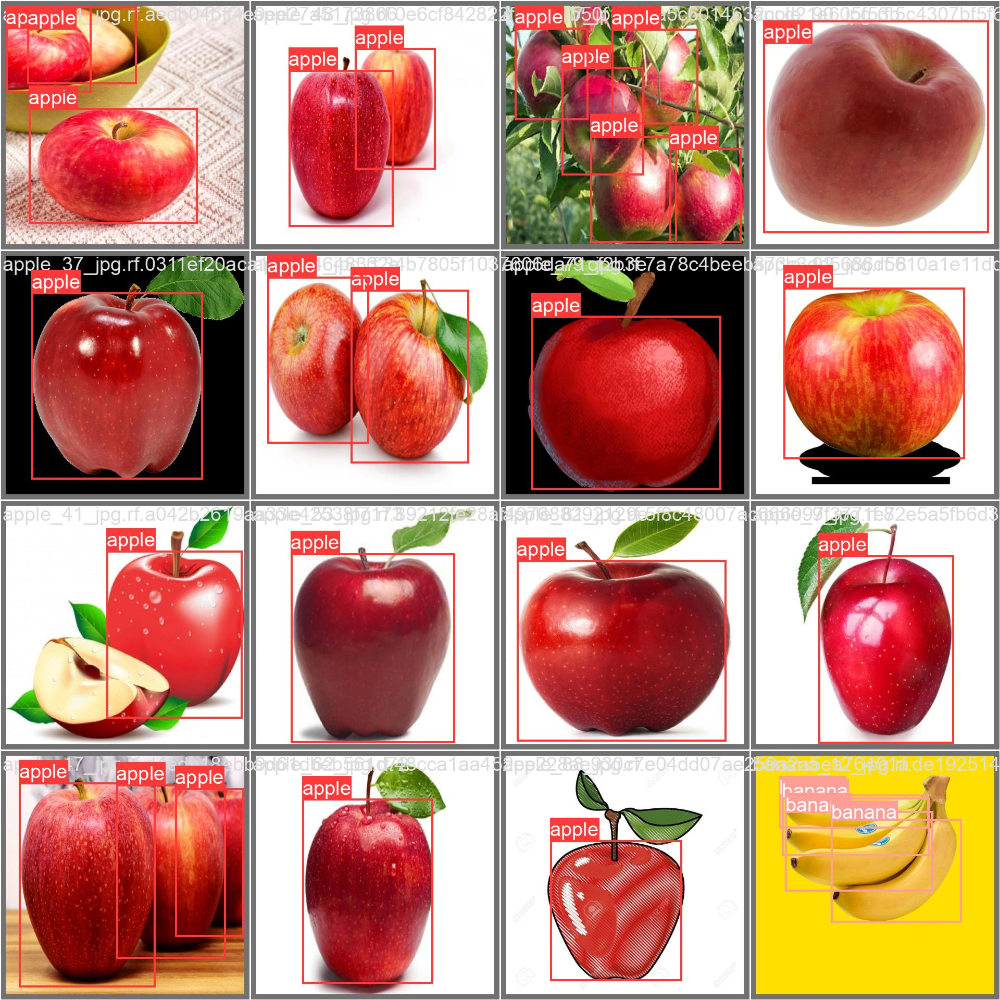

/content/runs/detect/train4/train_batch3602.jpg


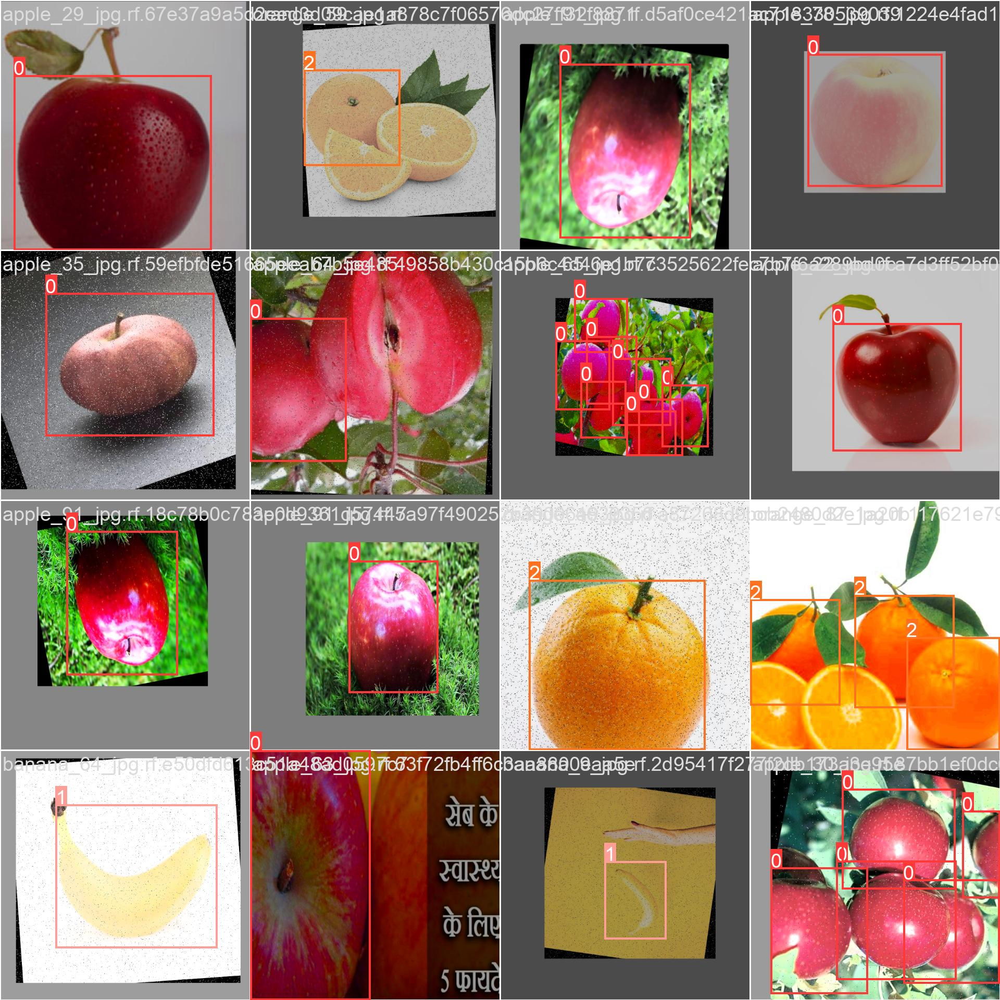

/content/runs/detect/train4/labels_correlogram.jpg


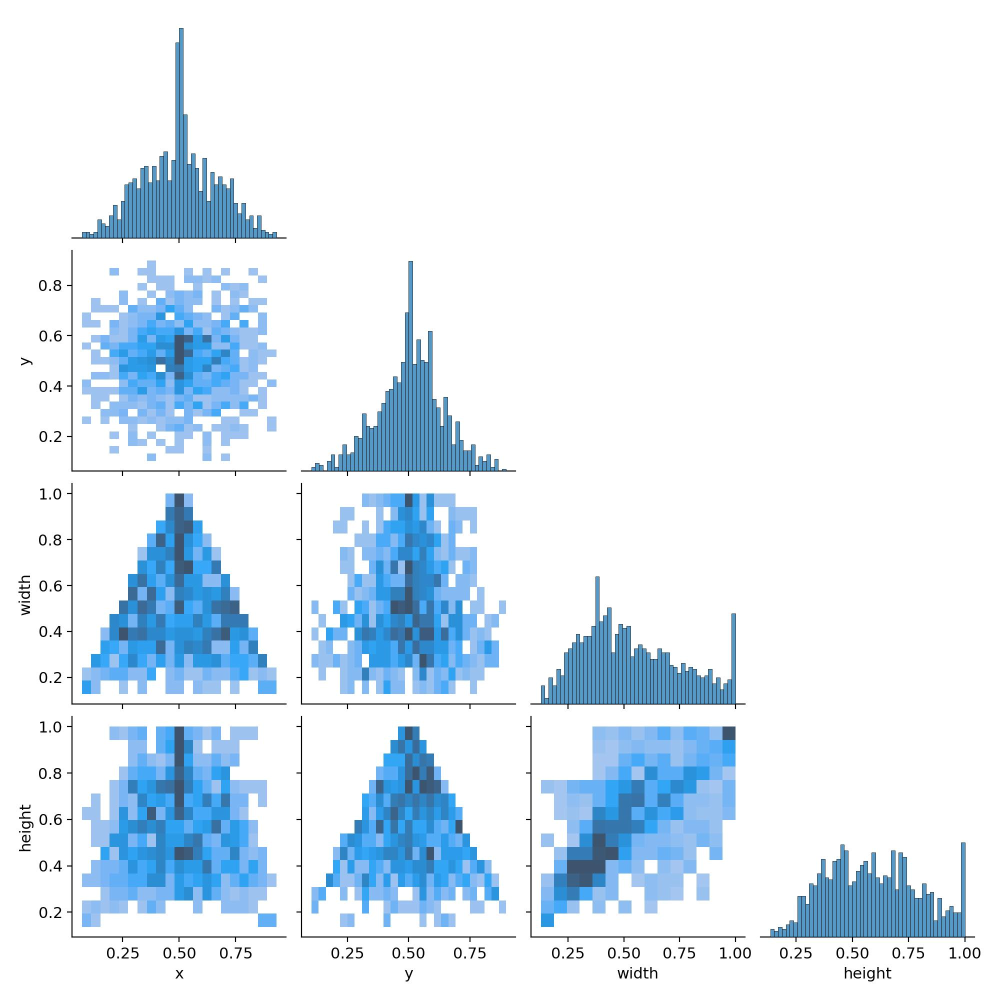

/content/runs/detect/train4/val_batch1_pred.jpg


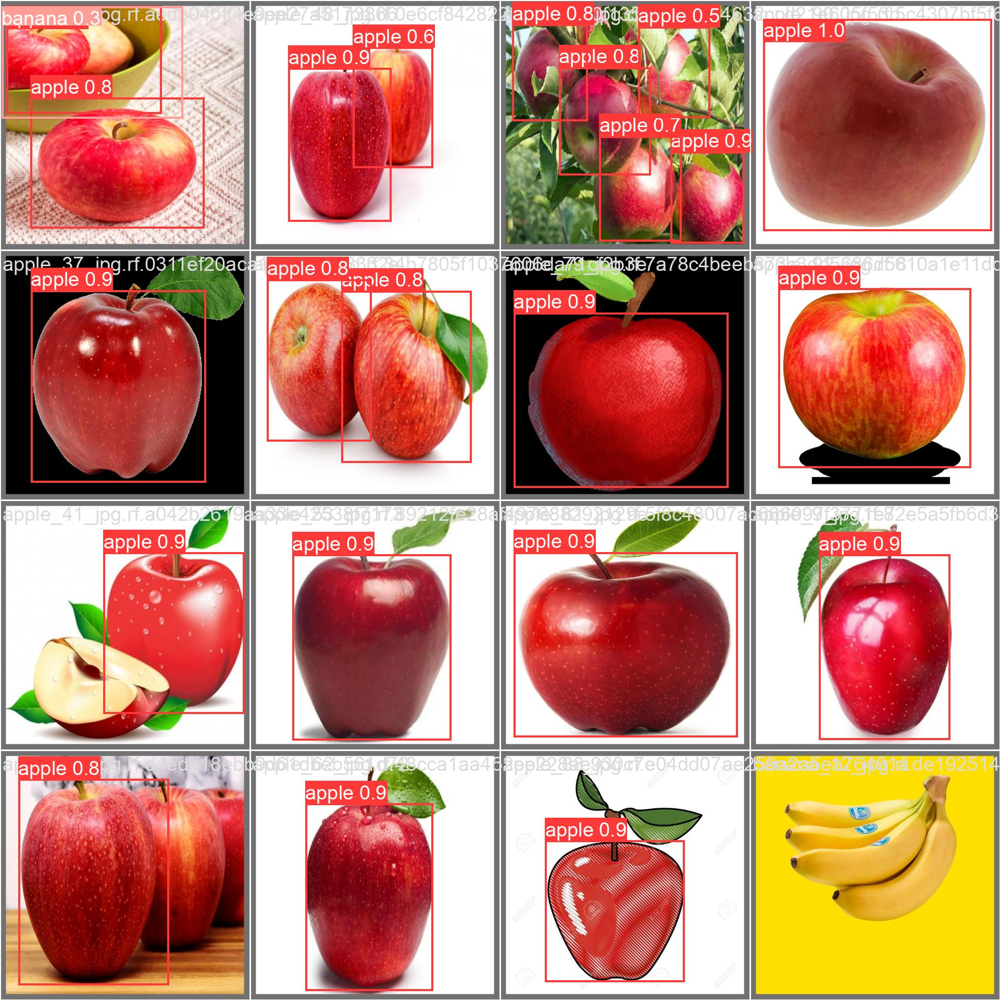

/content/runs/detect/train4/train_batch3600.jpg


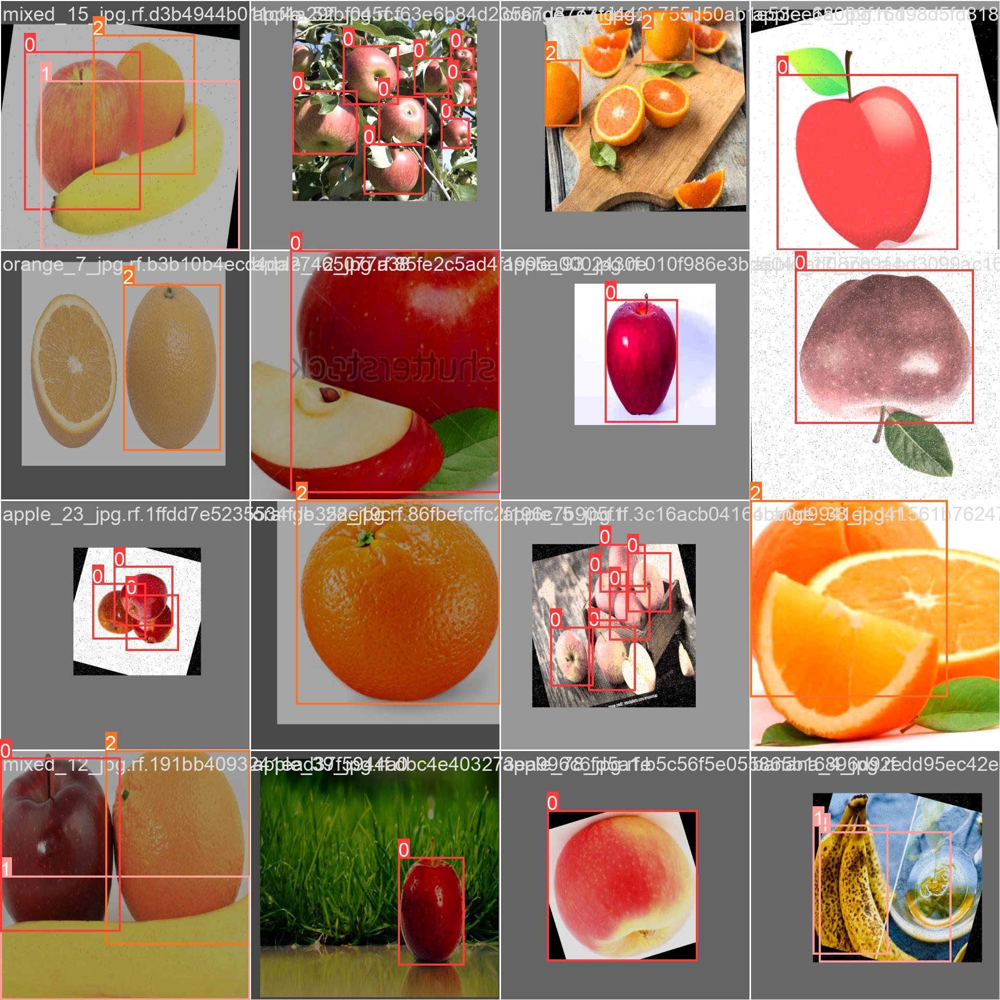

/content/runs/detect/train4/val_batch0_labels.jpg


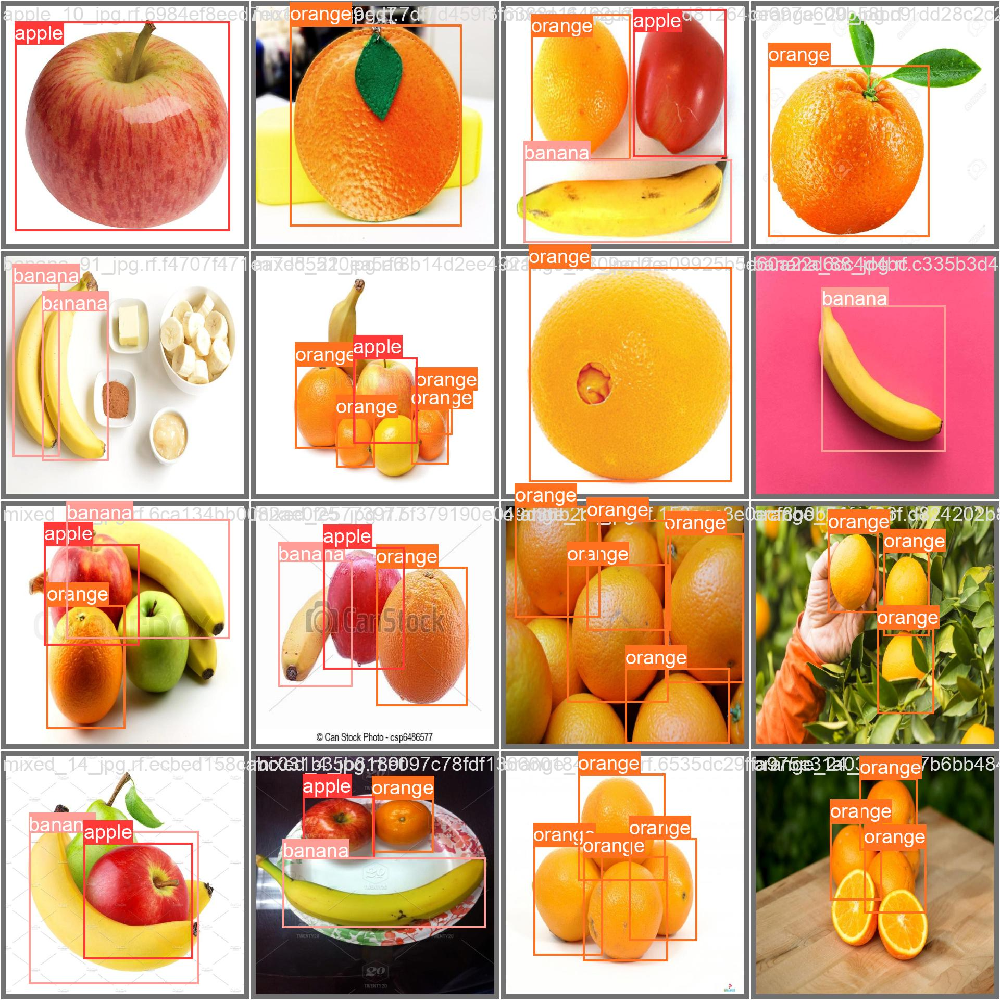

/content/runs/detect/train4/val_batch0_pred.jpg


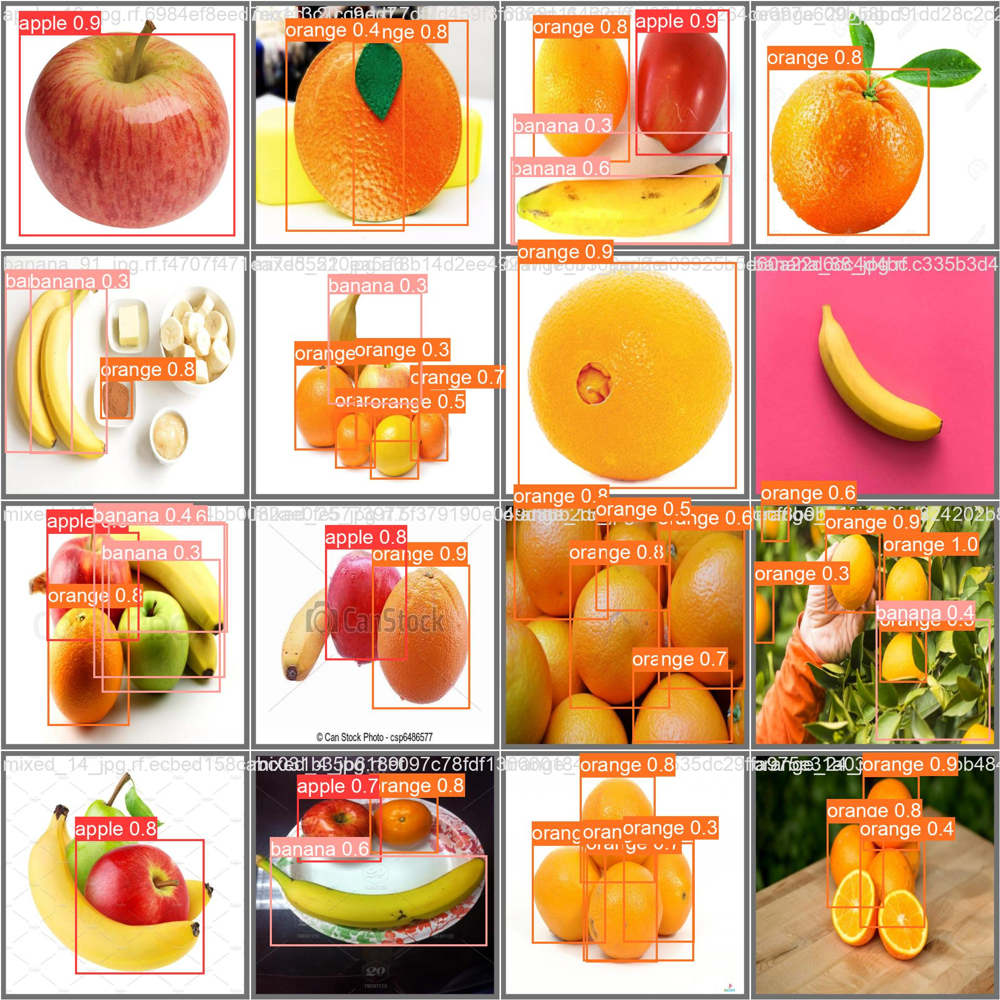

/content/runs/detect/train4/labels.jpg


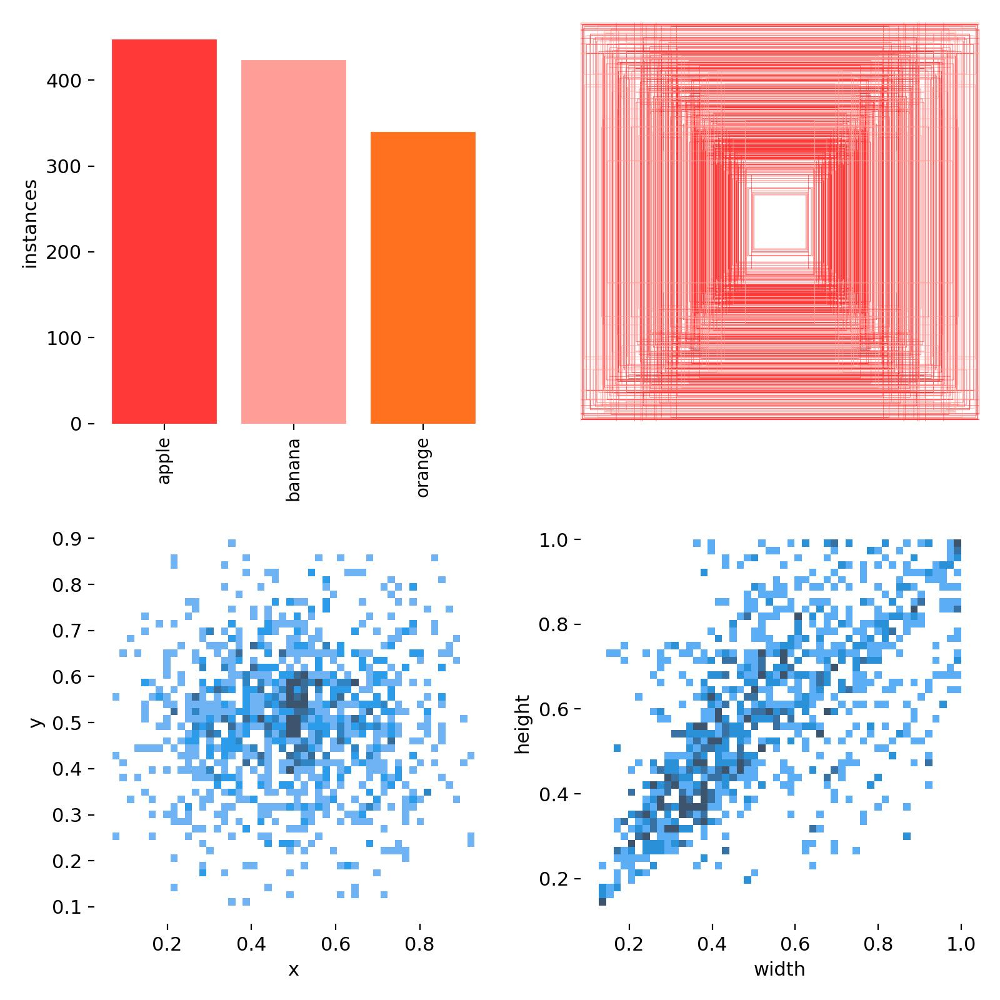

/content/runs/detect/train4/train_batch2.jpg


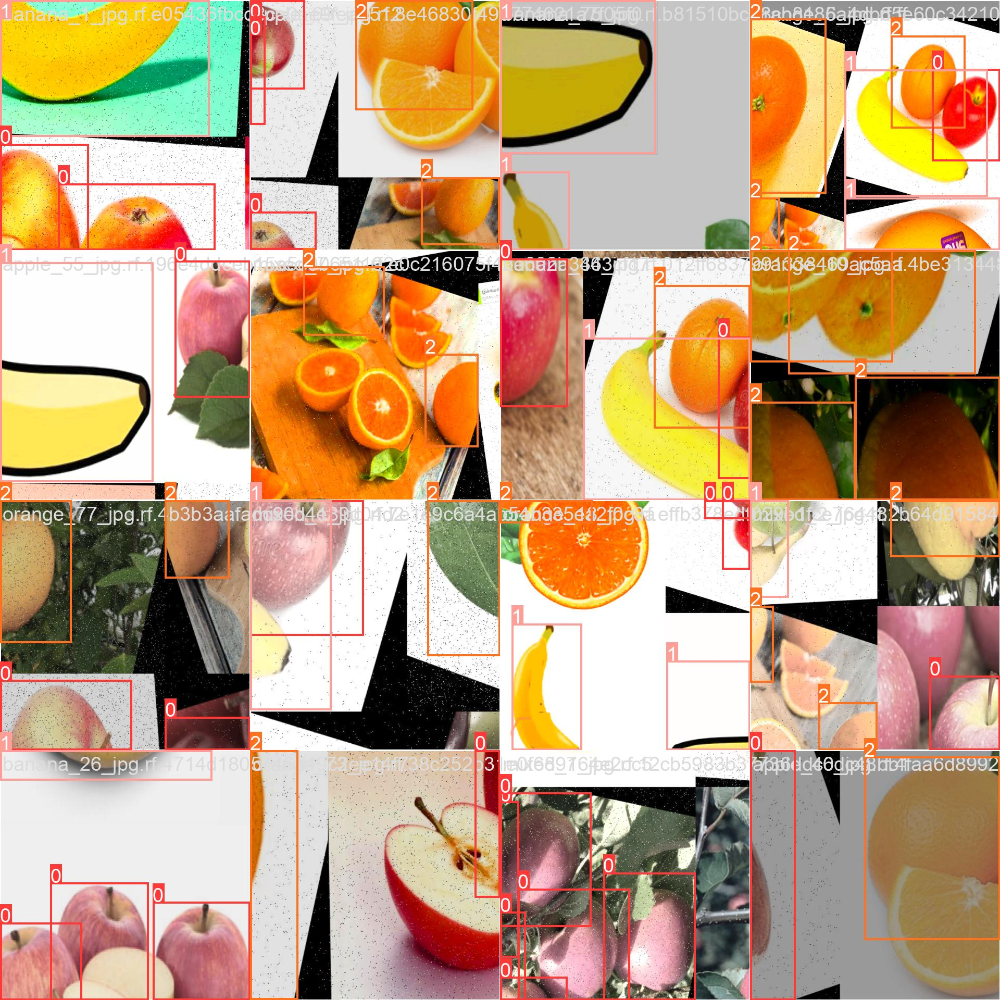

/content/runs/detect/train4/train_batch1.jpg


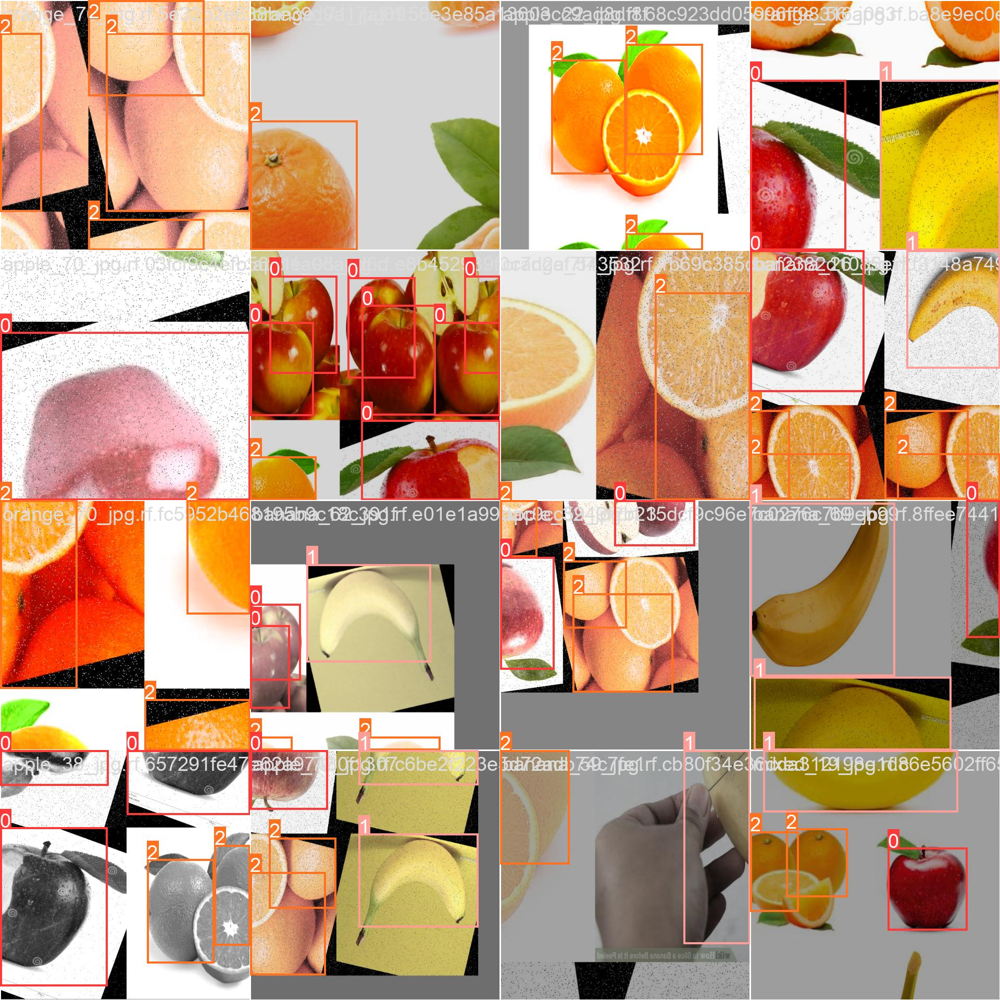

In [ ]:
file_path = glob.glob('/content/runs/detect/train4/*.png')
file_path += glob.glob('/content/runs/detect/train4/*.jpg')
for i in file_path:
  print(i)
  display(Image(filename=i, width=1000))


image 1/1 /content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg: 640x640 3 bananas, 20.8ms
Speed: 1.9ms preprocess, 20.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


Object type: banana
Coordinates: [42, 8, 407, 373]
Probability: 0.32
---
Object type: banana
Coordinates: [180, 197, 636, 623]
Probability: 0.28
---
Object type: banana
Coordinates: [0, 38, 163, 407]
Probability: 0.26
---
{0: 'apple', 1: 'banana', 2: 'orange'}


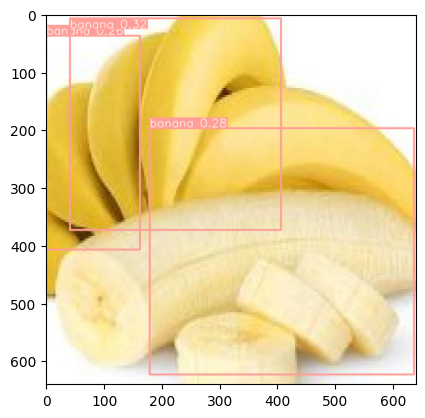

In [ ]:
test3 = new_model_2.predict("/content/Fruit_detection-1/test/images/banana_32_jpg.rf.9c4192038b38cefe834a90e58a083f53.jpg")
result = test3[0]
box = result.boxes[0]
for box in result.boxes:
  class_id = result.names[box.cls[0].item()]
  cords = box.xyxy[0].tolist()
  cords = [round(x) for x in cords]
  conf = round(box.conf[0].item(), 2)
  print("Object type:", class_id)
  print("Coordinates:", cords)
  print("Probability:", conf)
  print("---")

print(result.names)

plt.imshow(result.plot()[:,:,::-1])


image 1/1 /content/Fruit_detection-1/test/images/mixed_11_jpg.rf.c6aa222e1825745ef1ebdd5f18f9ae6f.jpg: 640x640 4 bananas, 1 orange, 16.8ms
Speed: 2.0ms preprocess, 16.8ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


Object type: orange
Coordinates: [232, 150, 432, 388]
Probability: 0.74
---
Object type: banana
Coordinates: [79, 173, 505, 460]
Probability: 0.43
---
Object type: banana
Coordinates: [69, 216, 556, 505]
Probability: 0.38
---
Object type: banana
Coordinates: [67, 284, 556, 556]
Probability: 0.34
---
Object type: banana
Coordinates: [192, 167, 550, 482]
Probability: 0.27
---


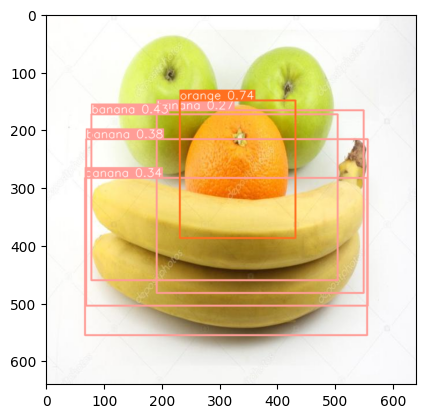

In [ ]:
test3 = new_model_2.predict("/content/Fruit_detection-1/test/images/mixed_11_jpg.rf.c6aa222e1825745ef1ebdd5f18f9ae6f.jpg")
result = test3[0]
box = result.boxes[0]
for box in result.boxes:
  class_id = result.names[box.cls[0].item()]
  cords = box.xyxy[0].tolist()
  cords = [round(x) for x in cords]
  conf = round(box.conf[0].item(), 2)
  print("Object type:", class_id)
  print("Coordinates:", cords)
  print("Probability:", conf)
  print("---")

plt.imshow(result.plot()[:,:,::-1])

In [ ]:
# Export the model
new_model_2.export()

Ultralytics YOLOv8.0.200 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/train4/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 7, 8400) (6.0 MB)

TorchScript: starting export with torch 2.1.0+cu118...
TorchScript: export success ✅ 2.0s, saved as 'runs/detect/train4/weights/best.torchscript' (11.9 MB)

Export complete (4.0s)
Results saved to /content/runs/detect/train4/weights
Predict:         yolo predict task=detect model=runs/detect/train4/weights/best.torchscript imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train4/weights/best.torchscript imgsz=640 data=/content/Fruit_detection-1/data.yaml  
Visualize:       https://netron.app


'runs/detect/train4/weights/best.torchscript'

In [ ]:
!zip -r '/content/yolov8-fruits.zip' '/content/runs/'

updating: content/runs/ (stored 0%)
  adding: content/runs/detect/ (stored 0%)
  adding: content/runs/detect/predict/ (stored 0%)
  adding: content/runs/detect/predict/bus.jpg (deflated 8%)
  adding: content/runs/detect/predict/zidane.jpg (deflated 10%)
  adding: content/runs/detect/val/ (stored 0%)
  adding: content/runs/detect/val/F1_curve.png (deflated 9%)
  adding: content/runs/detect/val/P_curve.png (deflated 11%)
  adding: content/runs/detect/val/R_curve.png (deflated 10%)
  adding: content/runs/detect/val/val_batch1_labels.jpg (deflated 15%)
  adding: content/runs/detect/val/confusion_matrix_normalized.png (deflated 28%)
  adding: content/runs/detect/val/val_batch2_labels.jpg (deflated 15%)
  adding: content/runs/detect/val/confusion_matrix.png (deflated 33%)
  adding: content/runs/detect/val/val_batch1_pred.jpg (deflated 14%)
  adding: content/runs/detect/val/PR_curve.png (deflated 17%)
  adding: content/runs/detect/val/val_batch2_pred.jpg (deflated 15%)
  adding: content/runs/

In [ ]:
!zip -r '/content/yolov8-fruits-dataset.zip' '/content/Fruit_detection-1'

updating: content/Fruit_detection-1/ (stored 0%)
  adding: content/Fruit_detection-1/data.yaml (deflated 47%)
  adding: content/Fruit_detection-1/valid/ (stored 0%)
  adding: content/Fruit_detection-1/valid/images/ (stored 0%)
  adding: content/Fruit_detection-1/valid/images/orange_21_jpg.rf.d824202b8bc2e98a75f7a1398fdaf869.jpg (deflated 0%)
  adding: content/Fruit_detection-1/valid/images/banana_91_jpg.rf.f4707f471ea7d55520ea5a60583eab94.jpg (deflated 5%)
  adding: content/Fruit_detection-1/valid/images/orange_84_jpg.rf.ca1227de018fa461e935ecb2406a5516.jpg (deflated 5%)
  adding: content/Fruit_detection-1/valid/images/banana_40_jpg.rf.e5137fcedccbf32e5234f4304ca51fdb.jpg (deflated 14%)
  adding: content/Fruit_detection-1/valid/images/apple_14_jpg.rf.633c50543a5676041a1ae72c5e9be597.jpg (deflated 0%)
  adding: content/Fruit_detection-1/valid/images/mixed_14_jpg.rf.ecbed158cabc031b35b6189f9460bf23.jpg (deflated 5%)
  adding: content/Fruit_detection-1/valid/images/apple_24_jpg.rf.aedb04b